## Preparing data

In [1]:
import scanpy as sc
adata=sc.read("data/adata_aligned.h5ad")

In [2]:
adata=sc.AnnData(adata.X,obs=adata.obs,var=adata.var)
adata.var["Gene"]=adata.var_names
adata.obs["CellID"]=adata.obs_names

In [3]:
adata

AnnData object with n_obs × n_vars = 2274 × 20699
    obs: 'batch', 'plate', 'devtime', 'n_genes_by_counts', 'total_counts', 'total_counts_ERCC', 'pct_counts_ERCC', 'leiden', 'CellID'
    var: 'ERCC', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Gene'

In [4]:
adata.write_loom("scenic/adata.loom")

```bash
wget -P  scenic/cisTarget_databases https://resources.aertslab.org/cistarget/motif2tf/motifs-v9-nr.mgi-m0.001-o0.0.tbl \
  https://resources.aertslab.org/cistarget/databases/mus_musculus/mm10/refseq_r80/mc9nr/gene_based/mm10__refseq-r80__500bp_up_and_100bp_down_tss.mc9nr.feather \
  https://resources.aertslab.org/cistarget/databases/mus_musculus/mm10/refseq_r80/mc9nr/gene_based/mm10__refseq-r80__10kb_up_and_down_tss.mc9nr.feather
  
wget -P scenic/ https://raw.githubusercontent.com/aertslab/pySCENIC/master/resources/mm_mgi_tfs.txt
```

## Run SCENIC

```bash
docker run -it --rm -v $(pwd)/scenic:/scenicdata \
    aertslab/pyscenic:0.11.2 pyscenic grn \
        --num_workers 40 \
        -o /scenicdata/adjacencies.tsv \
        /scenicdata/adata.loom \
        /scenicdata/mm_mgi_tfs.txt
        
        
docker run --rm -v $(pwd)/scenic:/scenicdata \
    aertslab/pyscenic:0.11.2 pyscenic ctx \
        /scenicdata/adjacencies.tsv \
        /scenicdata/cisTarget_databases/mm10__refseq-r80__10kb_up_and_down_tss.mc9nr.feather \
        /scenicdata/cisTarget_databases/mm10__refseq-r80__500bp_up_and_100bp_down_tss.mc9nr.feather \
        --annotations_fname /scenicdata/cisTarget_databases/motifs-v9-nr.mgi-m0.001-o0.0.tbl \
        --expression_mtx_fname /scenicdata/adata.loom \
        --mode "dask_multiprocessing" \
        --output /scenicdata/regulons.csv \
        --num_workers 40
           
    
docker run --rm -v $(pwd)/scenic:/scenicdata \
    aertslab/pyscenic:0.11.2 pyscenic aucell \
    /scenicdata/adata.loom \
    /scenicdata/regulons.csv \
    -o /scenicdata/scenic.loom \
    --num_workers 40
```

In [4]:
import loompy as lp
import pandas as pd
lf = lp.connect("scenic/scenic.loom", mode='r+', validate=False )
#exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID)
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)
regulons = lf.ra.Regulons

In [7]:
adata_tree=sc.read("data/adata_tree.h5ad")

In [8]:
adata=sc.AnnData(auc_mtx.loc[adata_tree.obs_names],
                 obs=adata_tree.obs,
                 uns=adata_tree.uns,obsm=adata_tree.obsm)

In [10]:
reg=[n.split("(")[0] for n in adata.var_names]

adata_tree=adata_tree[:,reg]

adata_tree.X[adata_tree.X>1]=1

Trying to set attribute `.X` of view, copying.


In [11]:
import numpy as np
adata.X=np.multiply(adata.X,adata_tree.X.A)

test features for association with the trajectory
    single mapping : 100%|██████████| 296/296 [00:18<00:00, 16.32it/s]
    found 89 significant features (0:00:18) --> added
    .var['p_val'] values from statistical test.
    .var['fdr'] corrected values from multiple testing.
    .var['st'] proportion of mapping in which feature is significant.
    .var['A'] amplitue of change of tested feature.
    .var['signi'] feature is significantly changing along pseudotime.
    .uns['stat_assoc_list'] list of fitted features on the graph for all mappings.
fit features associated with the trajectory
    single mapping : 100%|██████████| 89/89 [00:02<00:00, 39.02it/s]
    finished (adata subsetted to keep only fitted features!) (0:00:02) --> added
    .layers['fitted'], fitted features on the trajectory for all mappings.
    .raw, unfiltered data.


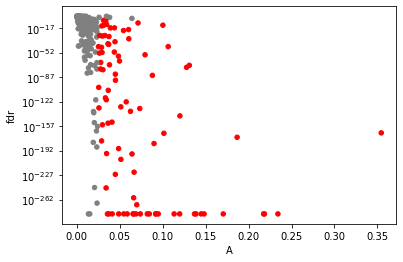

In [12]:
adata=adata[:,(adata.X>0).sum(axis=0)>5]
import scFates as scf
scf.tl.test_association(adata,n_jobs=20,A_cut=0.025)
scf.pl.test_association(adata)
adata.uns["pseudotime_list"][str(0)]=adata.uns["pseudotime_list"][str(0)].loc[adata.obs_names]
scf.tl.fit(adata,n_jobs=20)

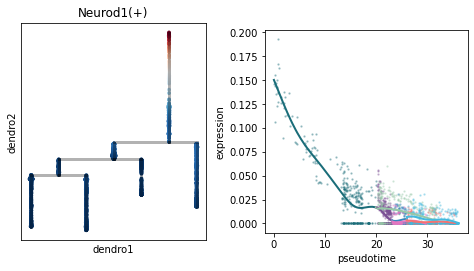

In [14]:
scf.pl.single_trend(adata,"Neurod1(+)",basis="dendro")

In [15]:
res=pd.concat([pd.Series(r.tolist(),index=regulons.dtype.names) for r in regulons],axis=1)

In [16]:
res.columns=lf.row_attrs["gene"]

In [17]:
res.loc["Neurod1(+)"]==1

Adora1    False
Sntg1     False
Bai3      False
Gpr39     False
Obsl1     False
          ...  
Nanos1    False
Prdx3     False
Sfxn4     False
Gm7102    False
Csf2ra    False
Name: Neurod1(+), Length: 20699, dtype: bool

In [18]:
pd.Series(res.columns[res.loc["Neurod1(+)"]==1]).to_csv("Neurod1_targets.tsv",header=None,index=None)

In [29]:
adata_genes=sc.read("data/adata_tree.h5ad")
adata_neurod1=adata_genes[:,res.columns[res.loc["Neurod1(+)"]==1]].copy().T

In [30]:
sc.pp.scale(adata_neurod1)

In [31]:
sc.pp.pca(adata_neurod1)

In [32]:
sc.pp.neighbors(adata_neurod1,metric="correlation")

In [33]:
sc.tl.leiden(adata_neurod1)

In [34]:
ll=adata_neurod1.obs.leiden.cat.categories
markers=dict(zip(ll,[adata_neurod1.obs_names[adata_neurod1.obs.leiden==c] for c in ll]))

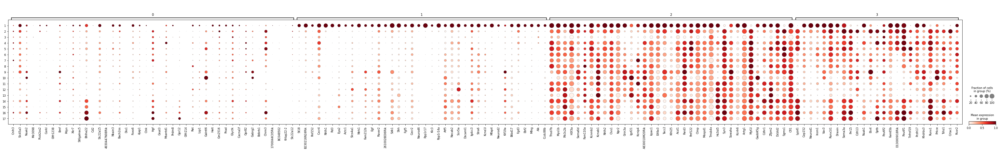

In [35]:
sc.pl.dotplot(adata_genes,markers,"leiden",standard_scale="var",save="Neurod1_targets.png")

In [36]:
sc.pp.scale(adata_genes)

In [37]:
sc.tl.score_genes(adata_genes,markers["1"],score_name="neurogenesis_targets")
sc.tl.score_genes(adata_genes,markers["3"],score_name="Ic_targets")

In [38]:
adata_genes.obs.t

SS2_20_133:A20    13.773944
SS2_20_133:B6      6.032589
SS2_20_133:B4      1.958453
SS2_20_133:A1      6.157872
SS2_20_133:B15     0.820903
                    ...    
SS2_19_168:P2     28.596877
SS2_19_168:P12    27.377409
SS2_19_168:P15    28.259502
SS2_19_168:P20    27.178890
SS2_19_168:P21    29.366955
Name: t, Length: 2005, dtype: float64

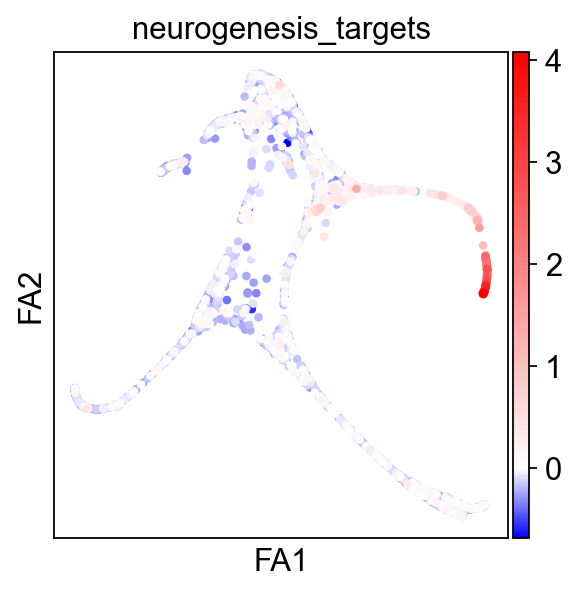

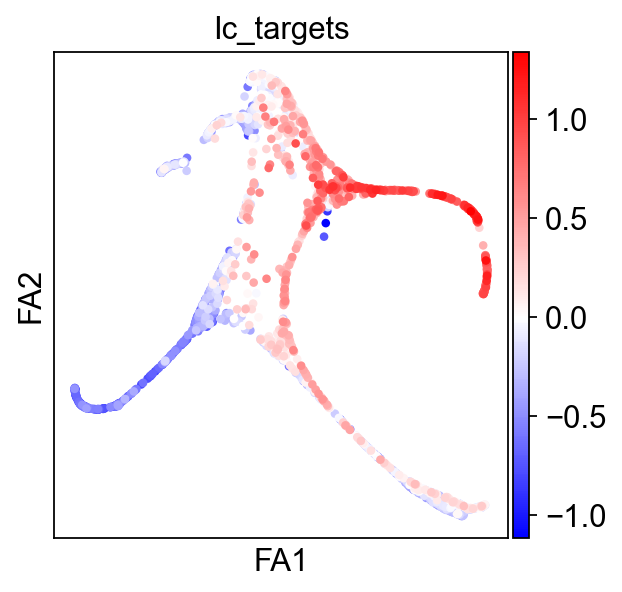

In [39]:
sc.set_figure_params()
sc.pl.draw_graph(adata_genes,color="neurogenesis_targets",vcenter=0,cmap="bwr")
sc.pl.draw_graph(adata_genes,color="Ic_targets",vcenter=0,cmap="bwr")

In [40]:
from scFates.tools.utils import importeR

In [41]:
a,b,rstats,rmgcv,Formula=importeR("test")

In [42]:
m = rmgcv.gam(
    Formula("neurogenesis_targets~s(t,bs='ts')"),
    data=adata_genes[adata_genes.obs.seg=="2"].obs,
    gamma=1.5,
)

df=pd.DataFrame({"t":adata_genes[adata_genes.obs.seg=="2"].obs.t.values,
              "fit":rmgcv.predict_gam(m)})
df.sort_values("t",inplace=True)

from kneed import KneeLocator
kneedle = KneeLocator(df.t, df.fit, S=1.0, curve="convex", direction="decreasing")

In [43]:
kneedle.knee

14.379488952112983

In [44]:
import scFates as scf

In [45]:
cols=pd.Series(adata_genes.uns["milestones_colors"],
          index=adata_genes.obs.milestones.cat.categories)

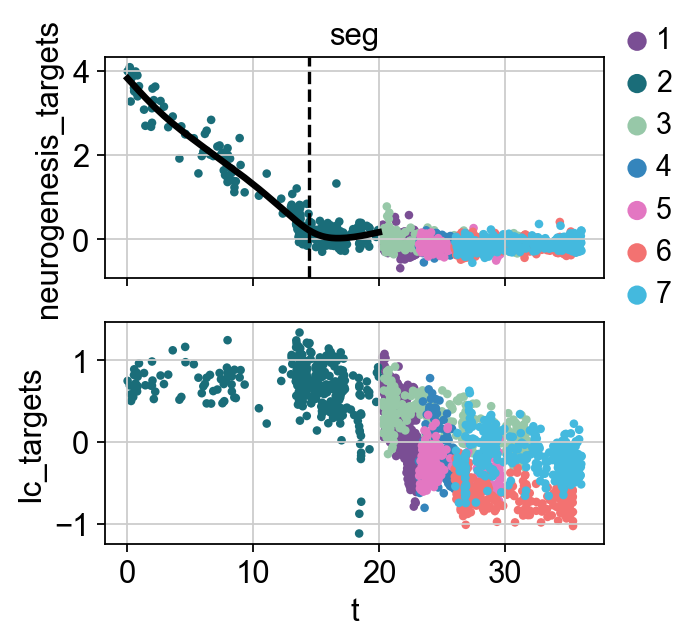

Text(0.5, 1.0, '')

In [46]:
import matplotlib.pyplot as plt
fig ,axs = plt.subplots(2,1,sharex=True)
sc.pl.scatter(adata_genes,x="t",y="neurogenesis_targets",color="seg",show=False,ax=axs[0])
axs[0].plot(df.t,df.fit,linewidth=3,color="k")
axs[0].set_xlabel("")
axs[0].axvline(kneedle.knee,linestyle="--",color="k")
sc.pl.scatter(adata_genes,x="t",y="Ic_targets",color="seg",title="",ax=axs[1],legend_loc="none")
axs[1].set_title("")

In [49]:
adata.obs["regime"]="immature"
adata.obs.loc[adata.obs.t>kneedle.knee,"regime"]="maturation"

In [50]:
adata.write("data/adata_scenic.h5ad")

/home/lfaure/miniconda3/envs/bio-gpu-18/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'regime' as categorical


In [31]:
import pandas as pd
adata_tree=sc.read("data/adata_tree.h5ad")
adata=sc.AnnData(auc_mtx.loc[adata_tree.obs_names],
                 obs=adata_tree.obs,
                 uns=adata_tree.uns,obsm=adata_tree.obsm)

In [32]:
reg=[n.split("(")[0] for n in adata.var_names]

In [33]:
adata_tree=adata_tree[:,reg]

In [34]:
adata_tree.X[adata_tree.X>1]=1

Trying to set attribute `.X` of view, copying.


In [35]:
import numpy as np
adata.X=np.multiply(adata.X,adata_tree.X.A)

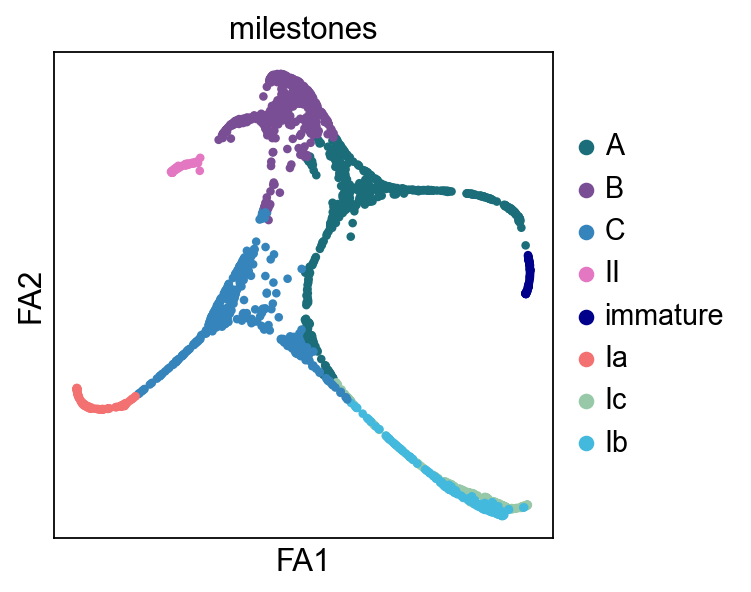

In [36]:
sc.pl.draw_graph(adata,color="milestones")

In [37]:
uns=adata.uns.copy()
adata=adata[adata.obs.t>kneedle.knee]
adata.uns=uns

In [38]:
adata=adata[:,(adata.X>0).sum(axis=0)>5]

import scFates as scf

scf.tl.test_association(adata,n_jobs=20,A_cut=0.025)

scf.pl.test_association(adata)

adata.uns["pseudotime_list"][str(0)]=adata.uns["pseudotime_list"][str(0)].loc[adata.obs_names]

scf.tl.fit(adata,n_jobs=20)

In [99]:
import numpy as np
import igraph
import pandas as pd
import matplotlib.patches as patches
import matplotlib.pyplot as plt

from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)
simplefilter(action='ignore', category=UserWarning)

def plot_updown(adata,ndots=3,ntops=4,key=None,cmap="RdBu_r",rev=False,gglst=adata.var_names):
    
    graph = adata.uns["graph"]

    dct = graph["milestones"]
    keys = np.array(list(dct.keys()))
    vals = np.array(list(dct.values()))

    edges = graph["pp_seg"][["from", "to"]].astype(str).apply(tuple, axis=1).values
    img = igraph.Graph(directed=True)
    img.add_vertices(vals.astype(str))
    img.add_edges(edges)

    allpaths=img.get_all_shortest_paths(str(graph["root"]),to=graph["tips"].astype(str))

    allpaths=np.array(allpaths)[np.argsort(np.array([len(p) for p in allpaths]))]

    order=allpaths[0]
    for i in range(1,len(allpaths)):
        order=order+np.array(allpaths[i])[~np.isin(allpaths[i],order)].tolist()

    order=np.array(order)[1:]

    order=pd.Series(graph["milestones"].keys(),index=graph["milestones"].values())[np.array(img.vs["name"])[order].astype(int)]
    order=pd.Series(range(len(adata.obs.seg.cat.categories)),index=graph["pp_seg"]["to"])[order.index].values
    
    if rev:
        order = order[::-1]

    vs2mils=pd.Series(dct.keys(),index=dct.values())

    #gglst=adata.var_names

    def get_seg(s):
        start=adata.obs.milestones[adata.obs.t[s.index].idxmin()]
        end=adata.obs.milestones[adata.obs.t[s.index].idxmax()]
        return pd.DataFrame([adata[s.index[s==c],gglst].X.A.mean(axis=0) for c in [start,end]],
                             index=[start,end],columns=gglst).T
    
    def get_seg(s):
        return pd.DataFrame([adata[s.index[s==i],gglst].X.A.mean(axis=0) for i in s.cat.categories],
                             index=s.cat.categories,columns=gglst).T
    
    cellsel=[adata.obs.milestones[adata.obs.seg==s] for s in adata.obs.seg.cat.categories[order]]
    cellsel=[pd.cut(adata.obs.t[adata.obs.seg==s],ndots) for s in adata.obs.seg.cat.categories[order]]

    res=pd.concat([get_seg(s) for s in cellsel],axis=1)
    res=(res.T/res.max(axis=1).values).T*200

    res=res.iloc[::-1,:]
    from matplotlib.colors import LinearSegmentedColormap, ListedColormap, BoundaryNorm
    import matplotlib.cm as cm

    fig, axs = plt.subplots(
        1,
        len(order),
        constrained_layout=True,
        sharey=True,
        figsize=(ndots*len(order) / 3, 2*len(gglst) / 7)

    )
    from mpl_toolkits.axes_grid1 import make_axes_locatable

    pos=np.arange(len(order),0,-1)
    for i,s in enumerate(np.arange(0,len(order)*ndots,ndots)):
        tocomp=res.iloc[:,s:s+ndots]
        if rev:
            tocomp=tocomp.iloc[:,::-1]
        xs = np.arange(tocomp.shape[0])
        ys = np.arange(tocomp.shape[1])
        X, Y = np.meshgrid(xs, ys)
        
        ss=int(adata.obs.seg.cat.categories[order[i]][0])
        sel=adata.obs.milestones.cat.categories==vs2mils[graph["pp_seg"].loc[ss]["from"]]
        print(sel)
        start=np.array(adata.uns["milestones_colors"])[sel][0]
        sel=adata.obs.milestones.cat.categories==vs2mils[graph["pp_seg"].loc[ss]["to"]]
        end=np.array(adata.uns["milestones_colors"])[sel][0]

        from matplotlib.colors import LinearSegmentedColormap
        
        m2m=[end,start] if rev else [start,end]
        my_cm=LinearSegmentedColormap.from_list("aspect",m2m)
        
        axs[i].scatter(
            Y, X, s=tocomp.values.T,c=tocomp.values.T,cmap=cmap,edgecolors='k',linewidth=.5
        )
        axs[i].grid(b=None)
        axs[i].set_yticks(range(tocomp.shape[0]));
        axs[i].set_yticklabels(gglst[::-1],style="italic",rotation=-45,va="bottom",ha="right");
        axs[i].set_xticks([])
        axs[i].set_xlim([-0.5, tocomp.shape[1] - 0.5])
        axs[i].set_ylim([-0.5, tocomp.shape[0] - 0.5])

        divider = make_axes_locatable(axs[i])
        cax = divider.new_vertical(size=.2, pad=0.05, pack_start=False)
        mappable = cm.ScalarMappable(cmap=my_cm)

        fig.add_axes(cax)
        cbar=fig.colorbar(mappable, cax=cax,orientation='horizontal')
        cbar.set_ticks([])

    #plt.savefig("figures/dotplot_updown.svg")

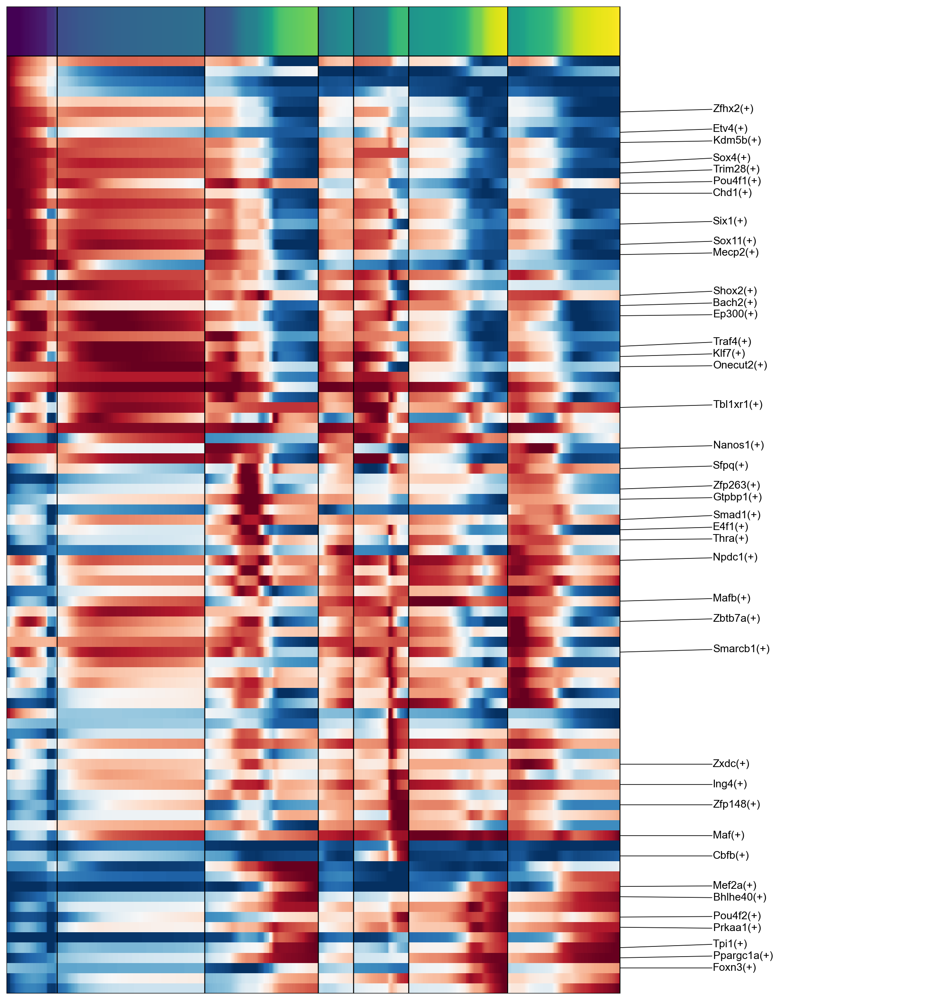

In [77]:
scf.pl.trends(adata,n_features=40,plot_emb=False,ordering="max",fig_heigth=20,ord_thre=.95,fontsize=12,save_genes="ordered_regulons.tsv")

In [78]:
reg=pd.read_csv("ordered_regulons.tsv",header=None).values.ravel()

In [79]:
from scipy.sparse import csr_matrix
adata.X=csr_matrix(adata.X)

In [80]:
c_early=pd.cut(adata.obs.loc[adata.obs.milestones=="A","t"],2)
c_early=c_early[c_early==c_early.cat.categories[0]].index

In [81]:
adata.obs.milestones=adata.obs.milestones.astype(str)

In [82]:
adata.obs.loc[c_early,"milestones"]="immature"

In [83]:
adata.obs.milestones=adata.obs.milestones.astype("category")

[False False False False False False False  True]
[ True False False False False False False False]
[ True False False False False False False False]
[False  True False False False False False False]
[False  True False False False False False False]
[False False  True False False False False False]
[False False  True False False False False False]


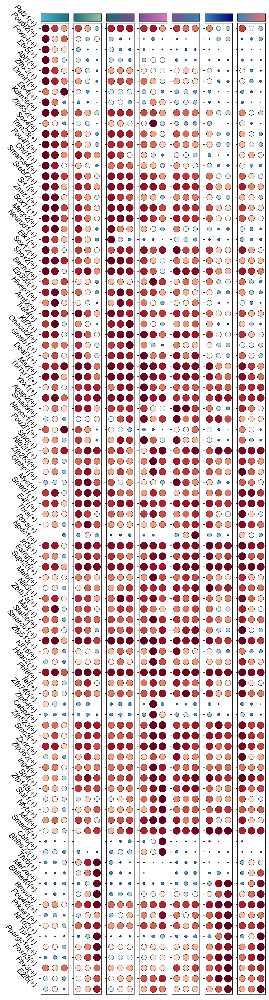

In [97]:
plot_updown(adata,cmap="RdBu_r",gglst=reg)

[False False  True False False False False False]
[False False  True False False False False False]
[False  True False False False False False False]
[False  True False False False False False False]
[ True False False False False False False False]
[ True False False False False False False False]
[False False False False False False False  True]


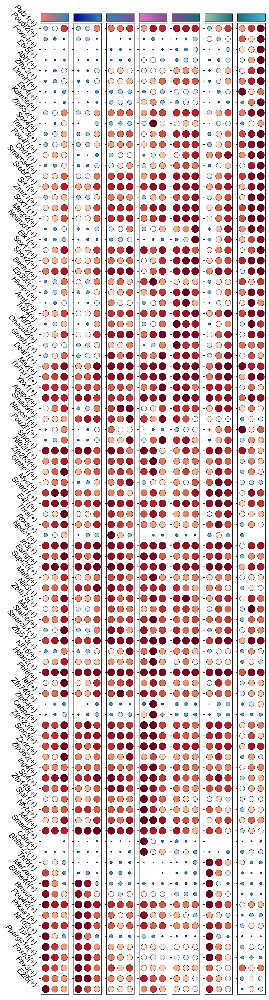

In [100]:
plot_updown(adata,cmap="RdBu_r",gglst=reg,rev=True)

[False False False False False False False  True]
[ True False False False False False False False]
[ True False False False False False False False]
[False  True False False False False False False]
[False  True False False False False False False]
[False False  True False False False False False]
[False False  True False False False False False]
[False False False False False False False  True]
[ True False False False False False False False]
[ True False False False False False False False]
[False  True False False False False False False]
[False  True False False False False False False]
[False False  True False False False False False]
[False False  True False False False False False]


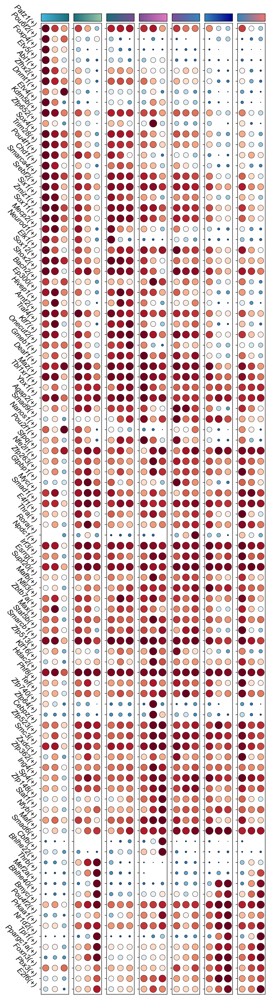

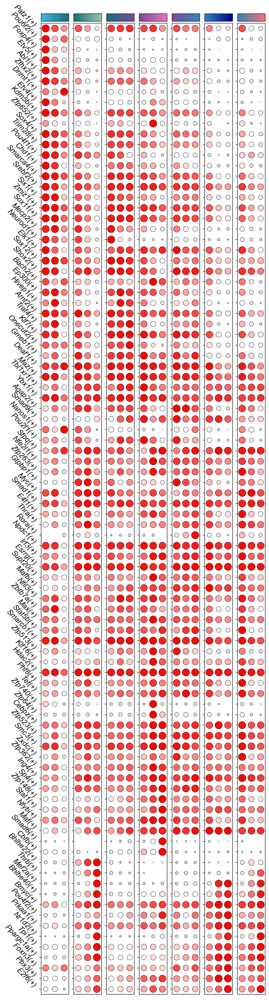

In [95]:
import matplotlib.pyplot as plt
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams['font.family'] = ['sans-serif']
plt.rcParams['font.sans-serif'] = ['Arial']

sc.set_figure_params()
from matplotlib.colors import LinearSegmentedColormap
cmap=LinearSegmentedColormap.from_list("aspect",["lightgrey","white","red"])

adata.uns=uns
plot_updown(adata,cmap="RdBu_r",gglst=reg)
plt.savefig("figures/regulons_overview.svg",bbox_inches="tight")

plot_updown(adata,cmap=cmap,gglst=reg)
plt.savefig("figures/regulons_overview_greyred_colormap.svg",bbox_inches="tight")

array(['Neurod2(+)', 'Foxo6(+)', 'Nhlh2(+)', 'Hcfc1(+)', 'Six4(+)',
       'Nhlh1(+)', 'Neurod1(+)', 'Zmiz1(+)', 'Zfp536(+)', 'Klf7(+)',
       'Atf2(+)', 'Zfp316(+)', 'Irx2(+)', 'Kdm5b(+)', 'Atf6b(+)',
       'Bach2(+)', 'Bclaf1(+)', 'Msc(+)', 'Etv1(+)', 'Isl2(+)'],
      dtype=object)

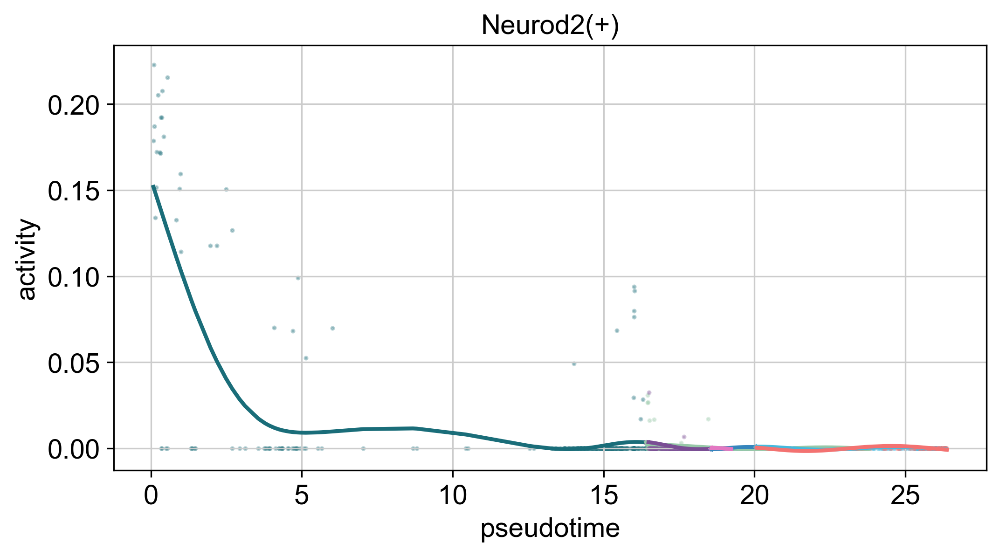

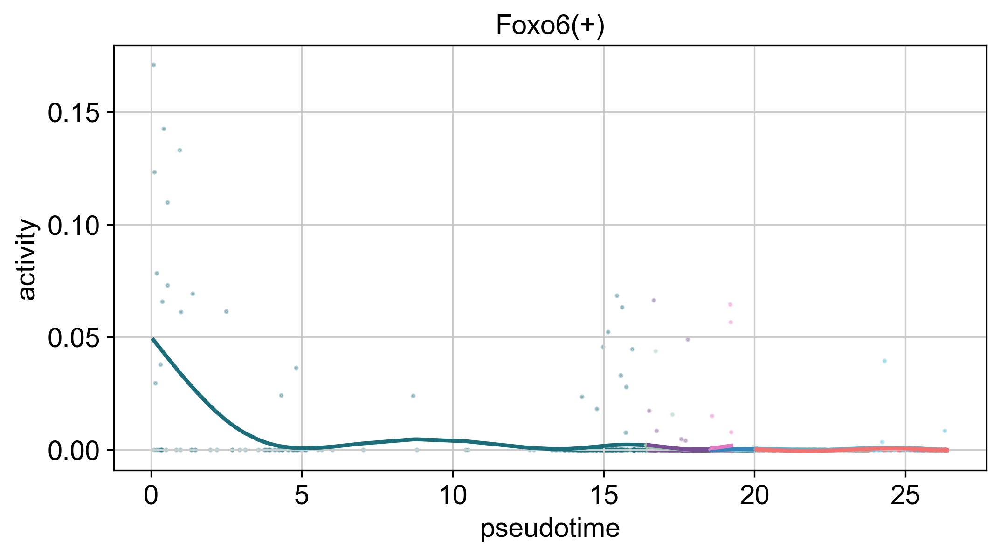

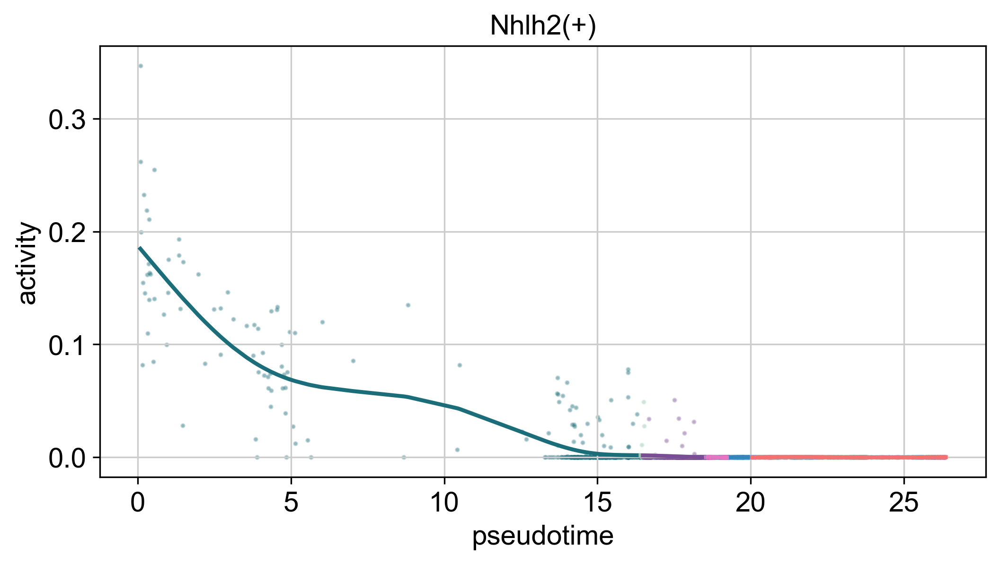

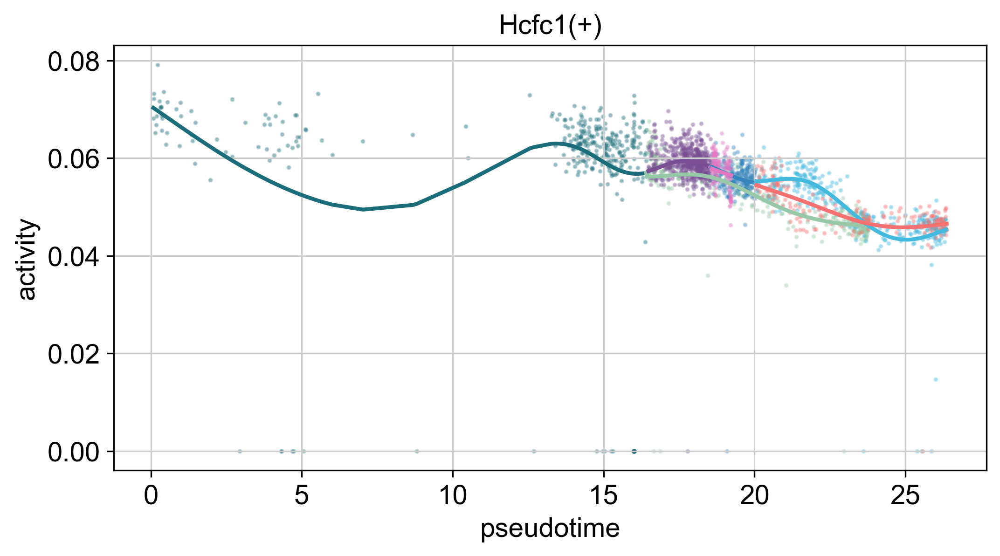

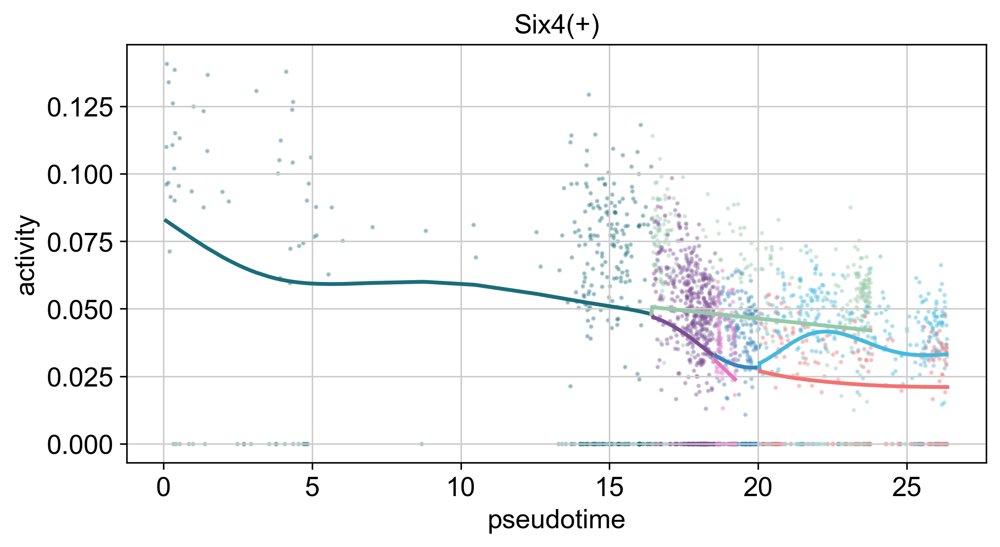

...

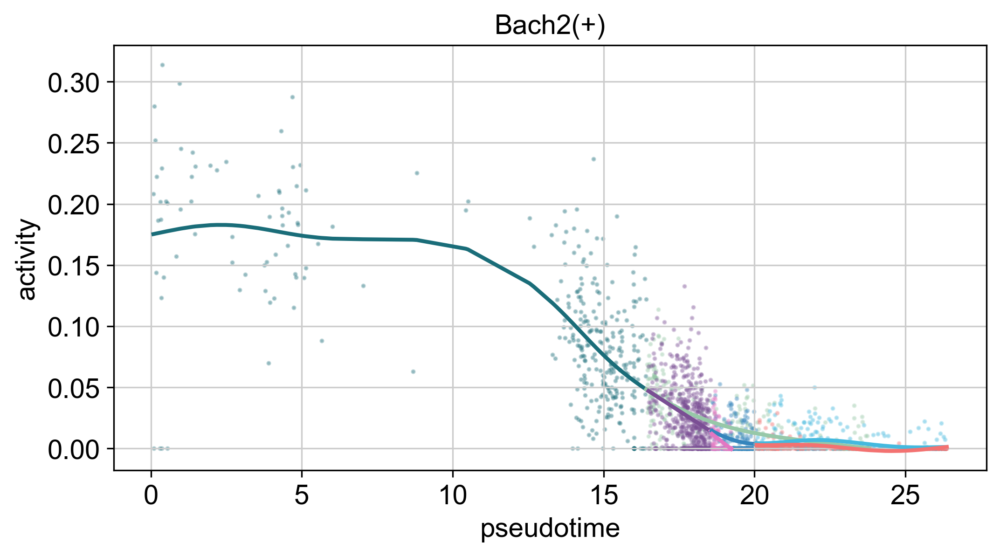

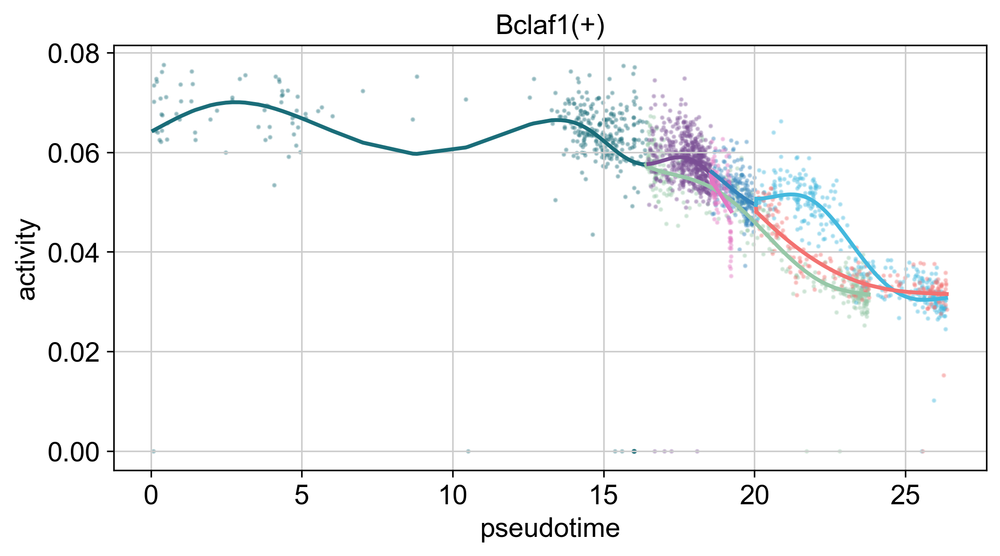

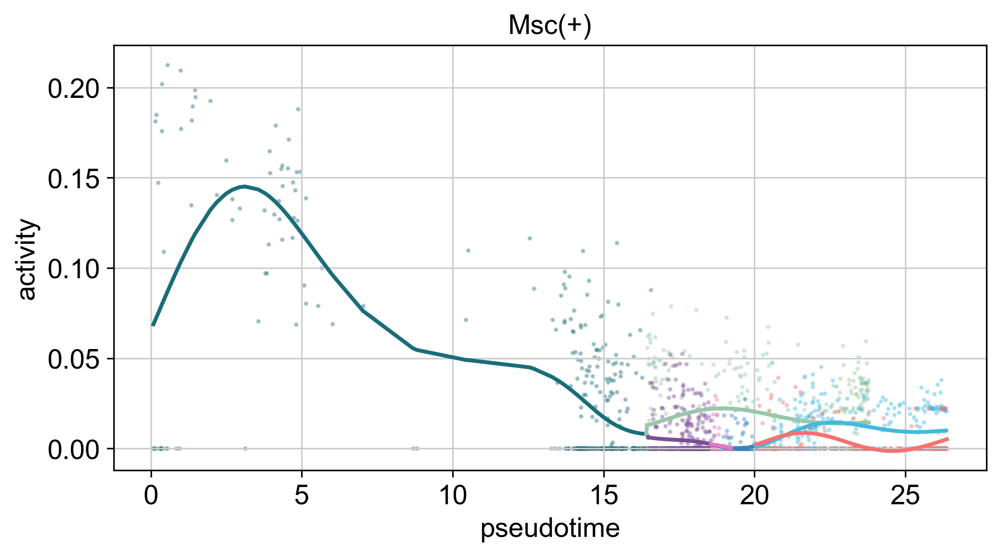

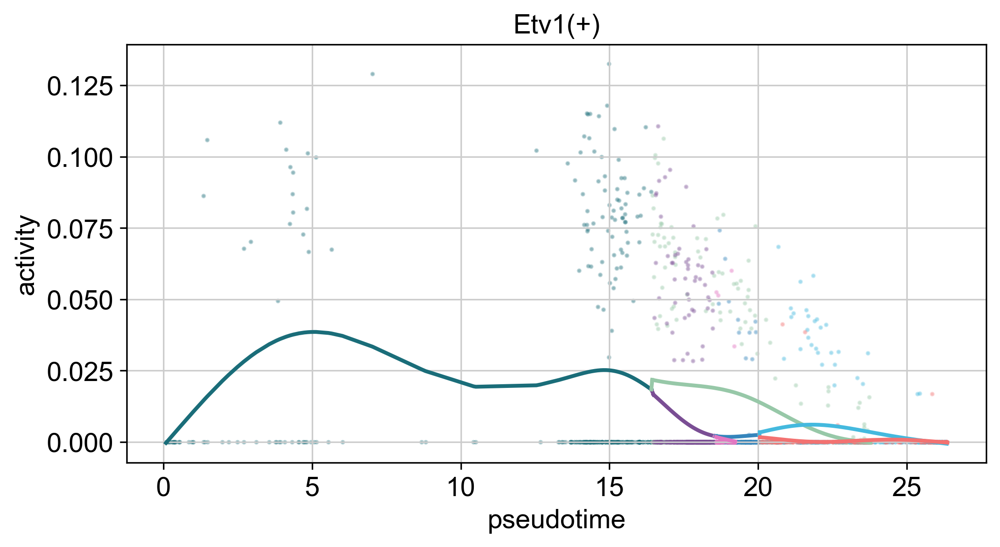

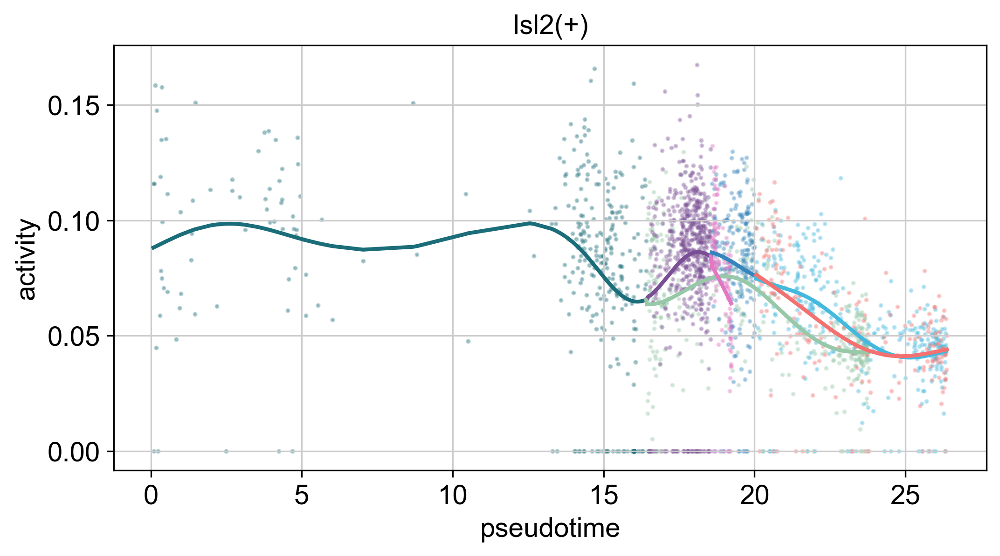

In [81]:
for g in reg[:20]:
    ax=scf.pl.single_trend(adata,g,show=False,plot_emb=False)
    ax.set_title(g)
    ax.set_ylabel("activity")
    plt.savefig("figures/regulon_trends_"+g+".png")

In [33]:
from matplotlib.colors import LinearSegmentedColormap
cmap=LinearSegmentedColormap.from_list("aspect",["lightgrey","white","red"])

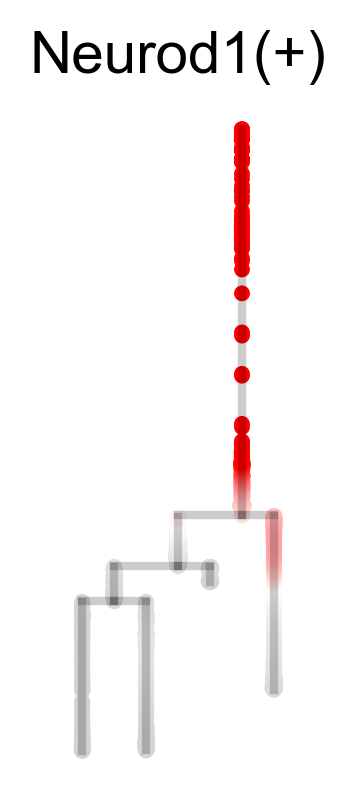

In [34]:
sc.set_figure_params(figsize=(1,3),frameon=False,dpi=150,dpi_save=600)
scf.pl.dendrogram(adata,color="Neurod1(+)",alpha_seg=.2,linewidth_seg=2,
                  show_info=False,cmap=cmap,layer="fitted",vmax="p95",save="_Neurod1_regulon.svg")

saving figure to file ./figures/scvelo_Neurod1_regulon.svg


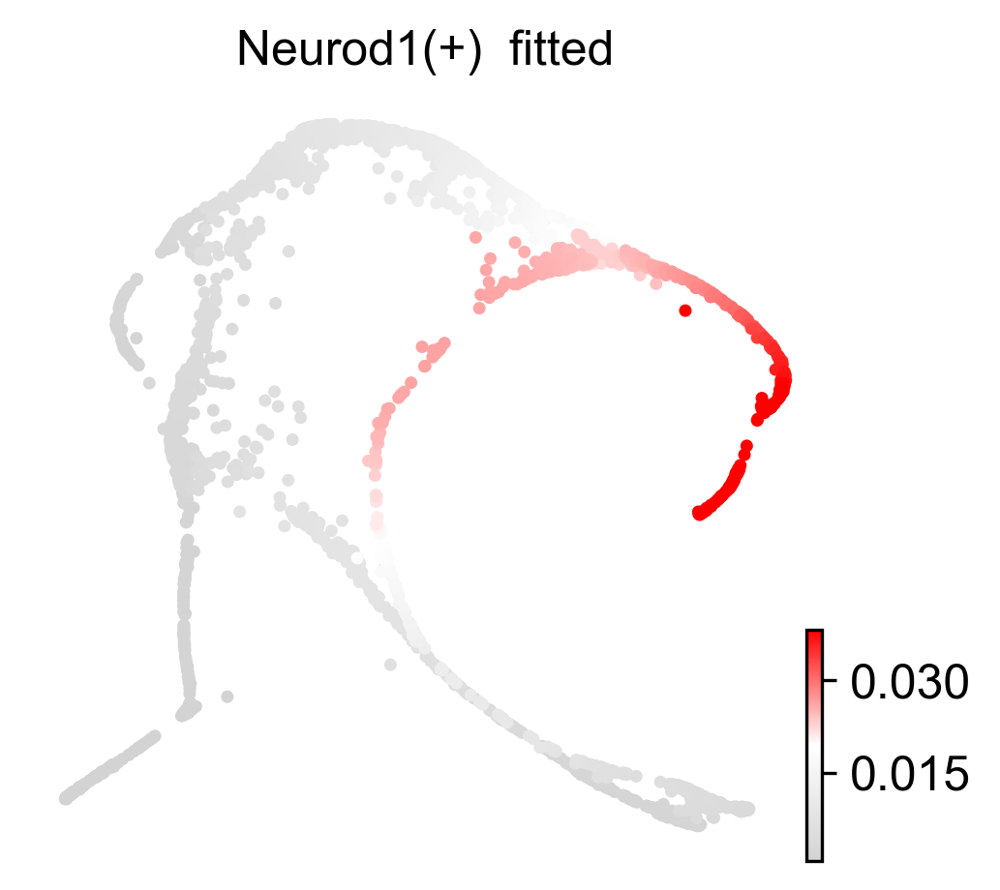

In [35]:
import scvelo as scv
scv.set_figure_params(frameon=False,figsize=(3.5,3.5),dpi=150,dpi_save=600)
scv.pl.draw_graph(adata,color="Neurod1(+)",cmap=cmap,layer="fitted",perc=[0,95],save="Neurod1_regulon.svg")

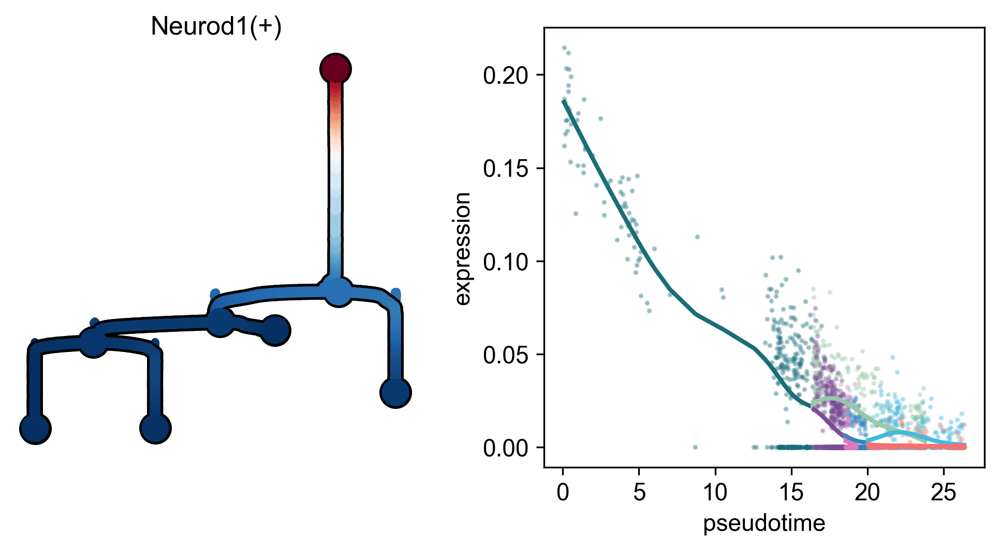

In [36]:
scf.pl.single_trend(adata,"Neurod1(+)",basis="dendro",)

subsetting tree
node 42 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:00) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.
    finished (0:00:00) --> tree extracted
--> added 
    .obs['old_milestones'], previous milestones from intial tree
test features for association with the trajectory
    single mapping : 100%|██████████| 74/74 [00:15<00:00,  4.84it/s]
    found 32 significant features (0:00:15) --> added
    .var['p_val'] values from statistical test.
    .var['fdr'] corrected values from multiple testing.
    .var['st'] proportion of mapping in which feature is significan

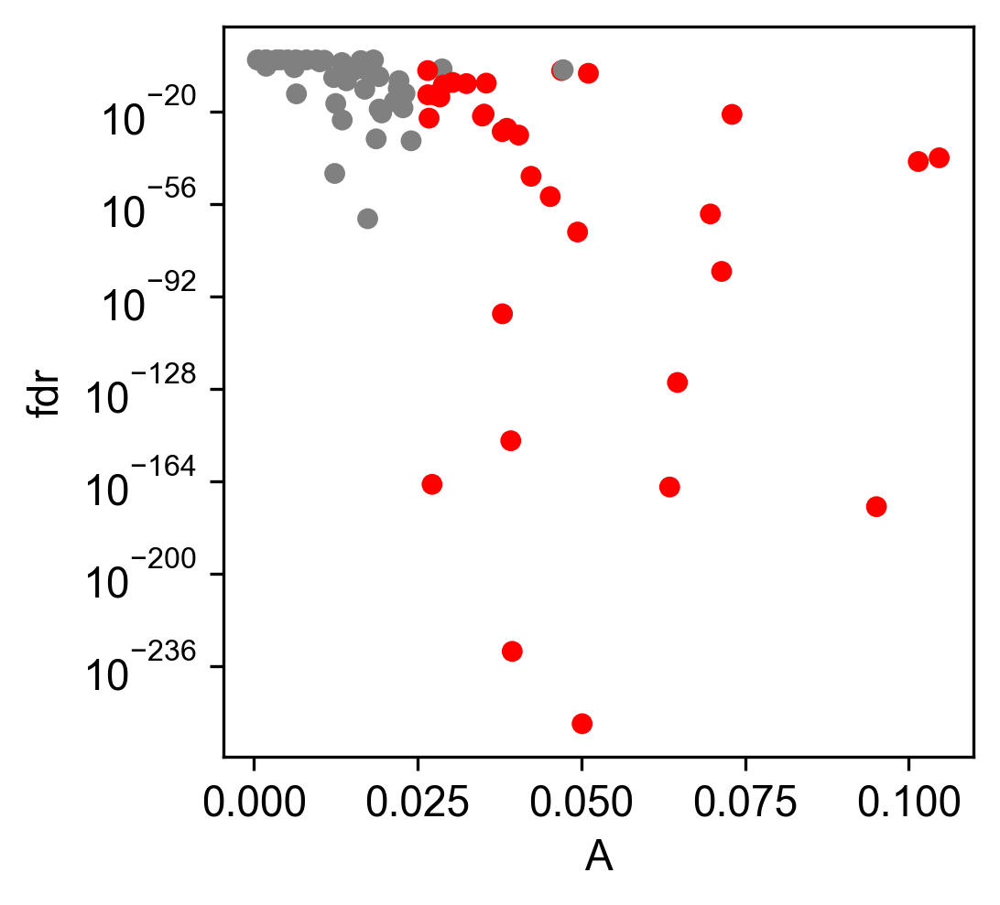

In [37]:
adata_Ic=scf.tl.subset_tree(adata,root_milestone="A",milestones=["Ic"],copy=True)
scf.tl.test_association(adata_Ic,n_jobs=40,A_cut=.025)
scf.pl.test_association(adata_Ic)
scf.tl.fit(adata_Ic,n_jobs=20)
#adata_Ic.write_h5ad("adata_Ic_tree.h5ad")

subsetting tree
node 91 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:00) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.
    finished (0:00:00) --> tree extracted
--> added 
    .obs['old_milestones'], previous milestones from intial tree
test features for association with the trajectory
    single mapping : 100%|██████████| 74/74 [00:14<00:00,  4.95it/s]
    found 23 significant features (0:00:14) --> added
    .var['p_val'] values from statistical test.
    .var['fdr'] corrected values from multiple testing.
    .var['st'] proportion of mapping in which feature is significan

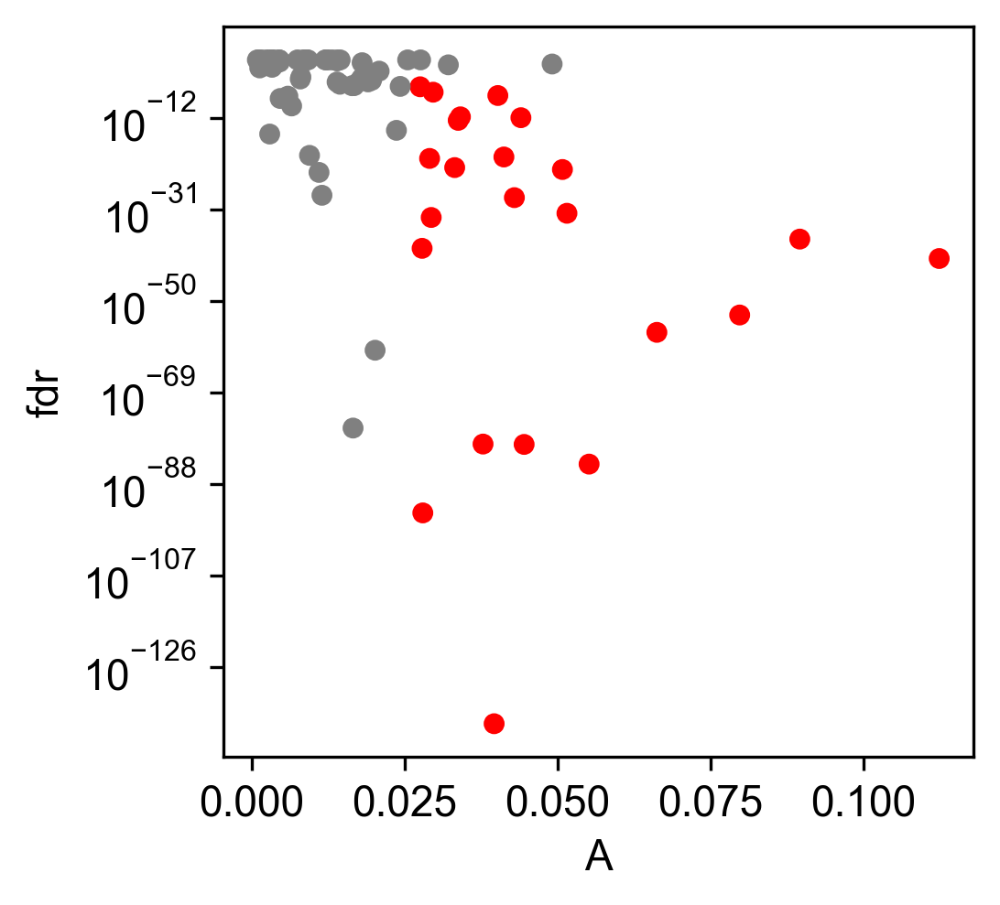

In [38]:
adata_II=scf.tl.subset_tree(adata,root_milestone="A",milestones=["II"],copy=True)
scf.tl.test_association(adata_II,n_jobs=40,A_cut=.025)
scf.pl.test_association(adata_II)
scf.tl.fit(adata_II,n_jobs=20)
#adata_II.write_h5ad("adata_II_tree.h5ad")

subsetting tree
node 149 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:02) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.
    finished (0:00:00) --> tree extracted
--> added 
    .obs['old_milestones'], previous milestones from intial tree
test features for association with the trajectory
    single mapping : 100%|██████████| 74/74 [00:15<00:00,  4.71it/s]
    found 38 significant features (0:00:15) --> added
    .var['p_val'] values from statistical test.
    .var['fdr'] corrected values from multiple testing.
    .var['st'] proportion of mapping in which feature is significa

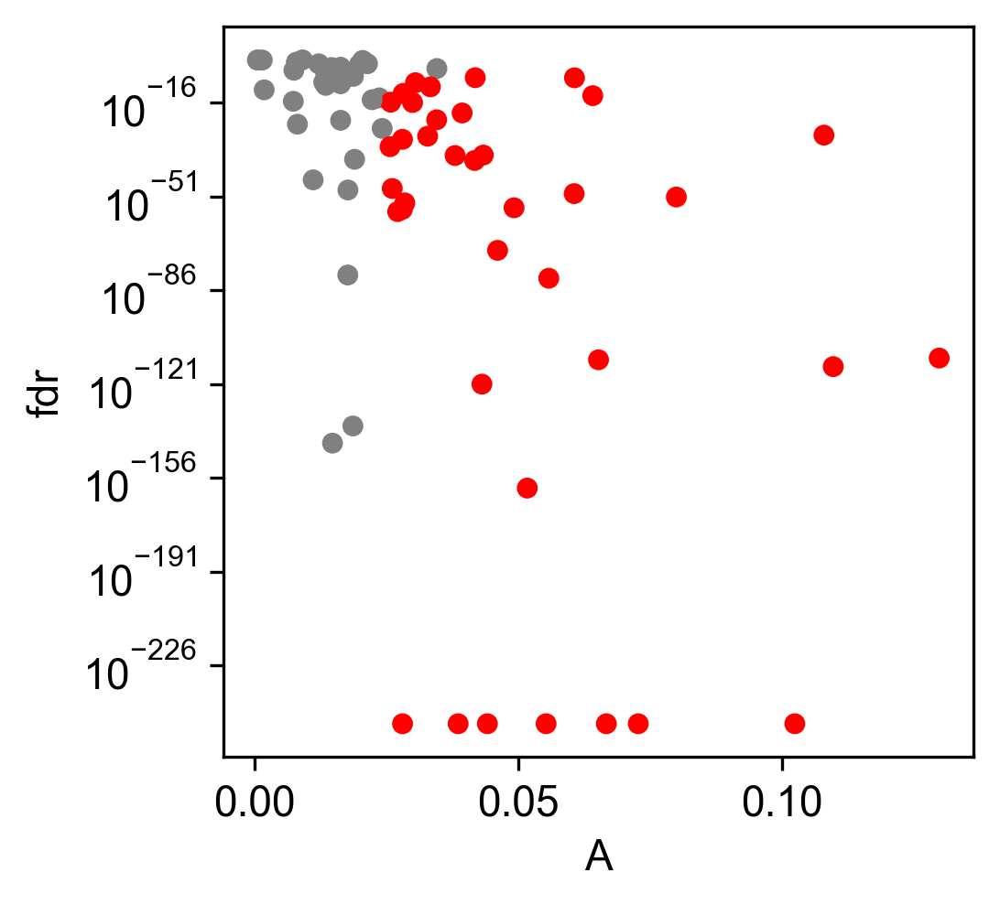

In [39]:
adata_Ia=scf.tl.subset_tree(adata,root_milestone="A",milestones=["Ia"],copy=True)
scf.tl.test_association(adata_Ia,n_jobs=40,A_cut=.025)
scf.pl.test_association(adata_Ia)
scf.tl.fit(adata_Ia,n_jobs=20)
#adata_Ia.write_h5ad("adata_Ia_tree.h5ad")

subsetting tree
node 111 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:01) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.
    finished (0:00:00) --> tree extracted
--> added 
    .obs['old_milestones'], previous milestones from intial tree
test features for association with the trajectory
    single mapping : 100%|██████████| 74/74 [00:15<00:00,  4.84it/s]
    found 40 significant features (0:00:15) --> added
    .var['p_val'] values from statistical test.
    .var['fdr'] corrected values from multiple testing.
    .var['st'] proportion of mapping in which feature is significa

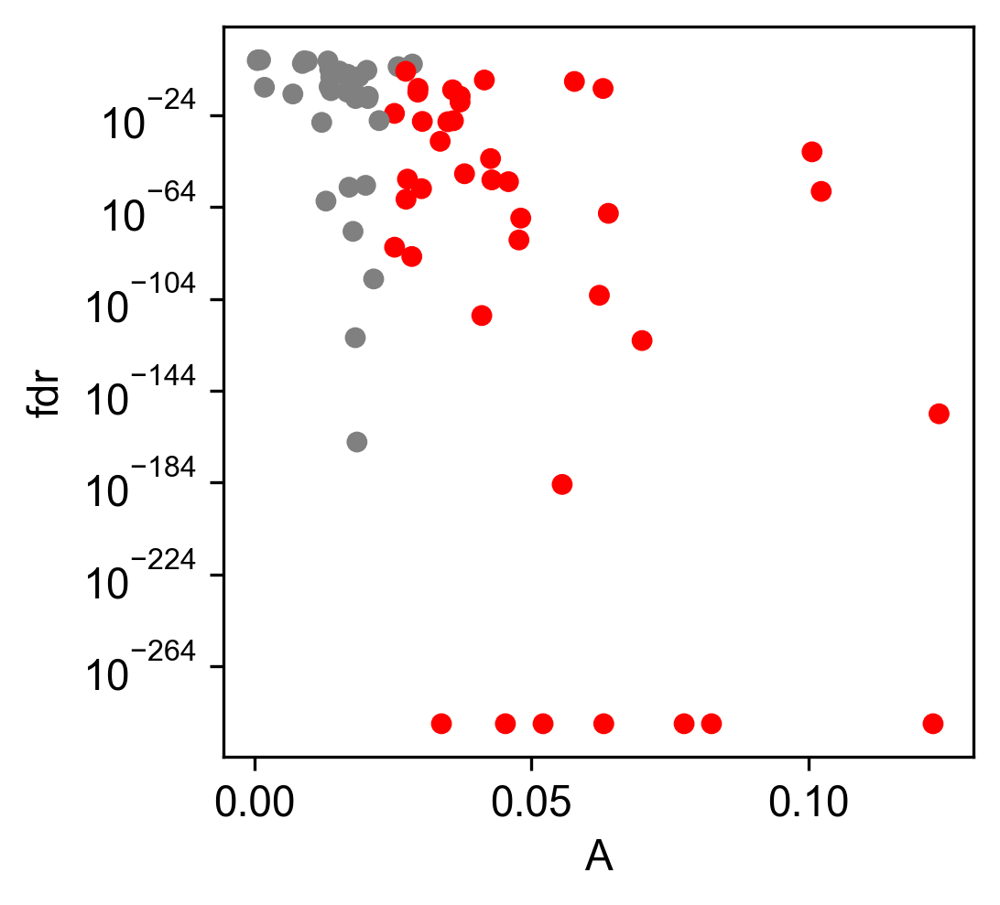

In [40]:
adata_Ib=scf.tl.subset_tree(adata,root_milestone="A",milestones=["Ib"],copy=True)
scf.tl.test_association(adata_Ib,n_jobs=40,A_cut=.025)
scf.pl.test_association(adata_Ib)
scf.tl.fit(adata_Ib,n_jobs=20)
#adata_Ib.write_h5ad("adata_Ib_tree.h5ad")

In [41]:
from scipy.stats import pearsonr
adata_Ia.var["corr"]=list(map(lambda g: pearsonr(adata_Ia.obs.t,adata_Ia[:,g].layers["fitted"].flatten())[0],adata_Ia.var_names))
adata_Ia.var["up"]=adata_Ia.var["corr"]>0
adata_Ib.var["corr"]=list(map(lambda g: pearsonr(adata_Ib.obs.t,adata_Ib[:,g].layers["fitted"].flatten())[0],adata_Ib.var_names))
adata_Ib.var["up"]=adata_Ib.var["corr"]>0
adata_Ic.var["corr"]=list(map(lambda g: pearsonr(adata_Ic.obs.t,adata_Ic[:,g].layers["fitted"].flatten())[0],adata_Ic.var_names))
adata_Ic.var["up"]=adata_Ic.var["corr"]>0
adata_II.var["corr"]=list(map(lambda g: pearsonr(adata_II.obs.t,adata_II[:,g].layers["fitted"].flatten())[0],adata_II.var_names))
adata_II.var["up"]=adata_II.var["corr"]>0

In [42]:
dct=dict(zip(["Ia","Ib","Ic","II"],[adata_Ia,adata_Ib,adata_Ic,adata_II]))

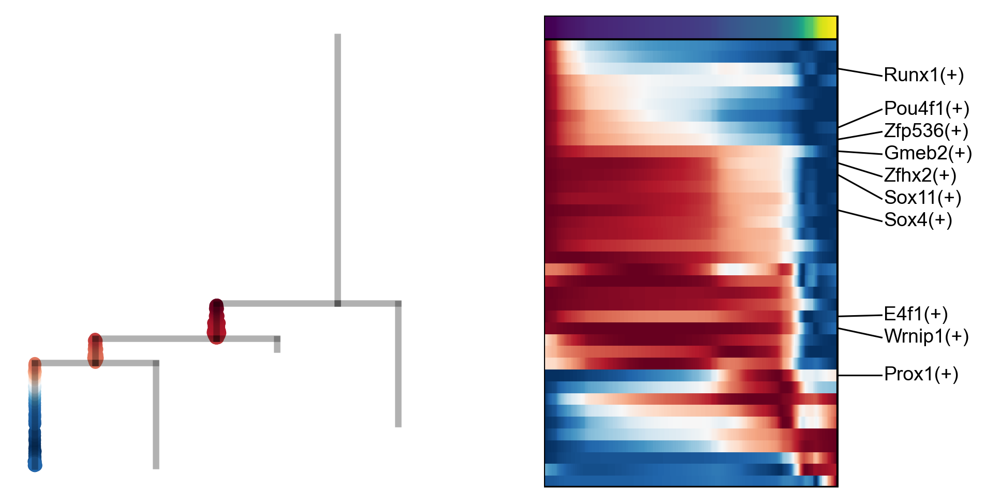

In [43]:
scf.pl.trends(adata_Ia,basis="dendro",ordering="max")

In [44]:
ups=pd.concat([pd.DataFrame({ct:1},index=ad.var_names[ad.var.up]) for ct,ad in dct.items()],axis=1).fillna(0)
downs=pd.concat([pd.DataFrame({ct:1},index=ad.var_names[~ad.var.up]) for ct,ad in dct.items()],axis=1).fillna(0)

In [45]:
ups

,Ia,Ib,Ic,II
Jdp2(+),1.0,0.0,0.0,1.0
Maf(+),1.0,1.0,1.0,1.0
Mafb(+),1.0,0.0,1.0,1.0
Mef2d(+),1.0,0.0,0.0,1.0
Nr1d1(+),1.0,1.0,0.0,0.0
Pbx3(+),1.0,0.0,0.0,1.0
Pou4f2(+),1.0,1.0,0.0,1.0
Ppargc1a(+),1.0,1.0,1.0,0.0
Prox1(+),1.0,1.0,1.0,0.0
Zfp426(+),1.0,1.0,1.0,0.0


In [46]:
alles=pd.concat([pd.DataFrame({ct:1},index=ad.var_names) for ct,ad in dct.items()],axis=1).fillna(0)

In [47]:
alles.idxmax(axis=1)[alles.sum(axis=1)==1].index

Index(['Atf2(+)', 'Hsf1(+)', 'Rora(+)', 'Zfp711(+)', 'Bhlhe22(+)',
       'Zfp354c(+)'],
      dtype='object')

In [48]:
alles

,Ia,Ib,Ic,II
Bach2(+),1.0,1.0,1.0,1.0
Bcl11a(+),1.0,1.0,1.0,1.0
Bclaf1(+),1.0,1.0,1.0,0.0
Crebzf(+),1.0,1.0,1.0,0.0
E4f1(+),1.0,1.0,1.0,0.0
Etv4(+),1.0,1.0,0.0,1.0
Gmeb2(+),1.0,1.0,1.0,0.0
Isl2(+),1.0,1.0,1.0,1.0
Jdp2(+),1.0,0.0,0.0,1.0
Kdm5b(+),1.0,1.0,1.0,0.0


In [50]:
ups.idxmax(axis=1)[ups.sum(axis=1)==1].index

Index(['Bcl11a(+)', 'Rora(+)', 'Runx1(+)', 'Bhlhe22(+)', 'Mafg(+)'], dtype='object')

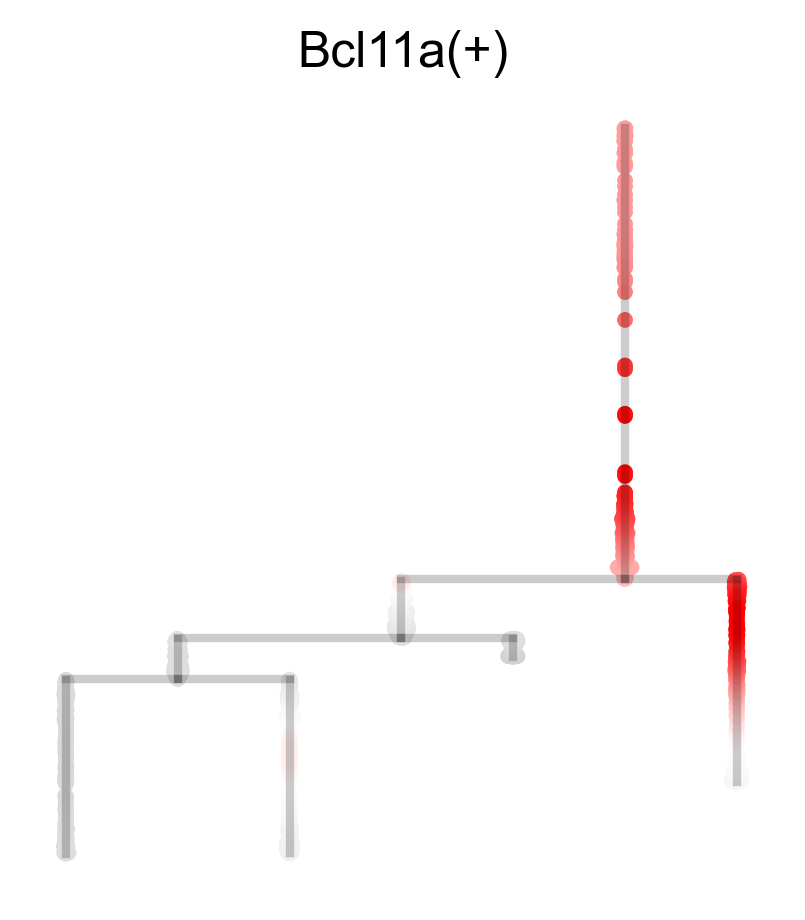

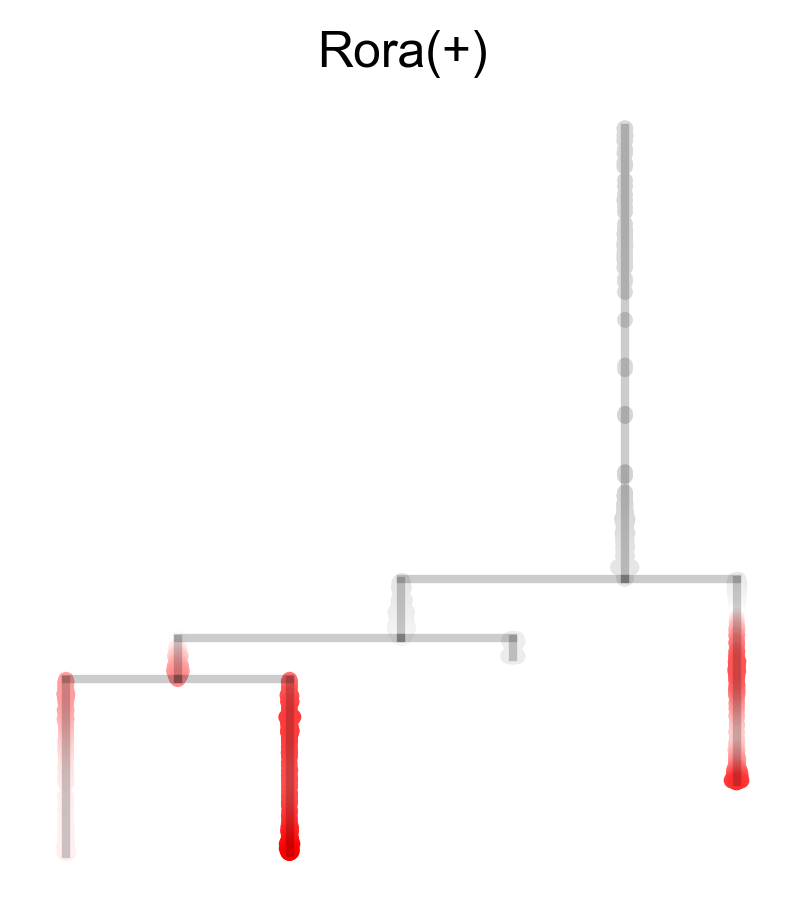

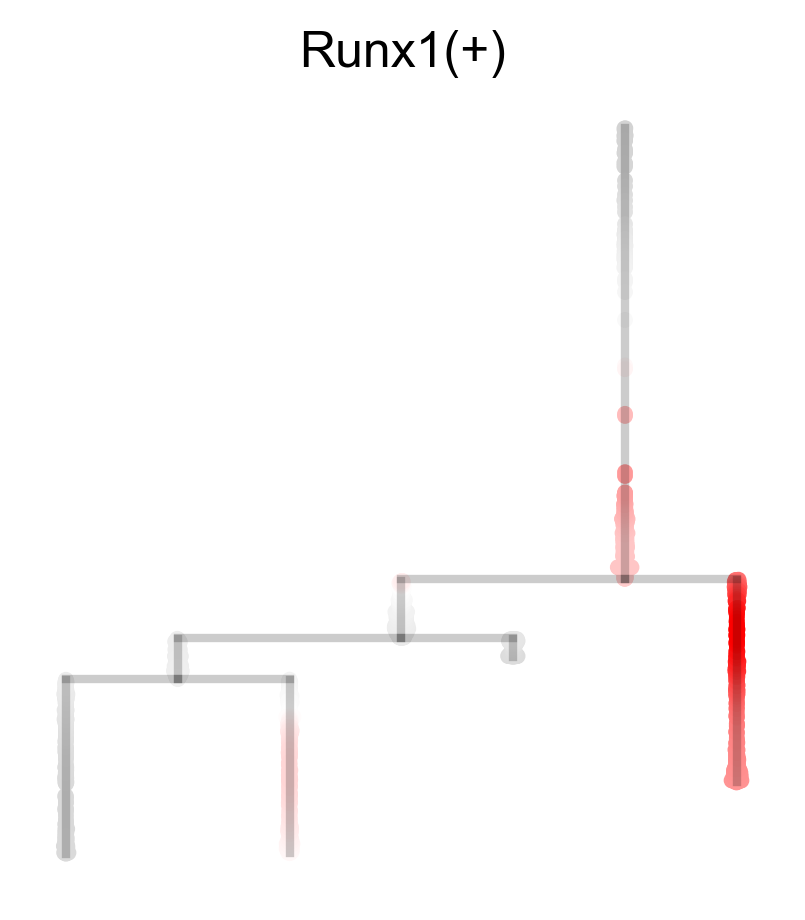

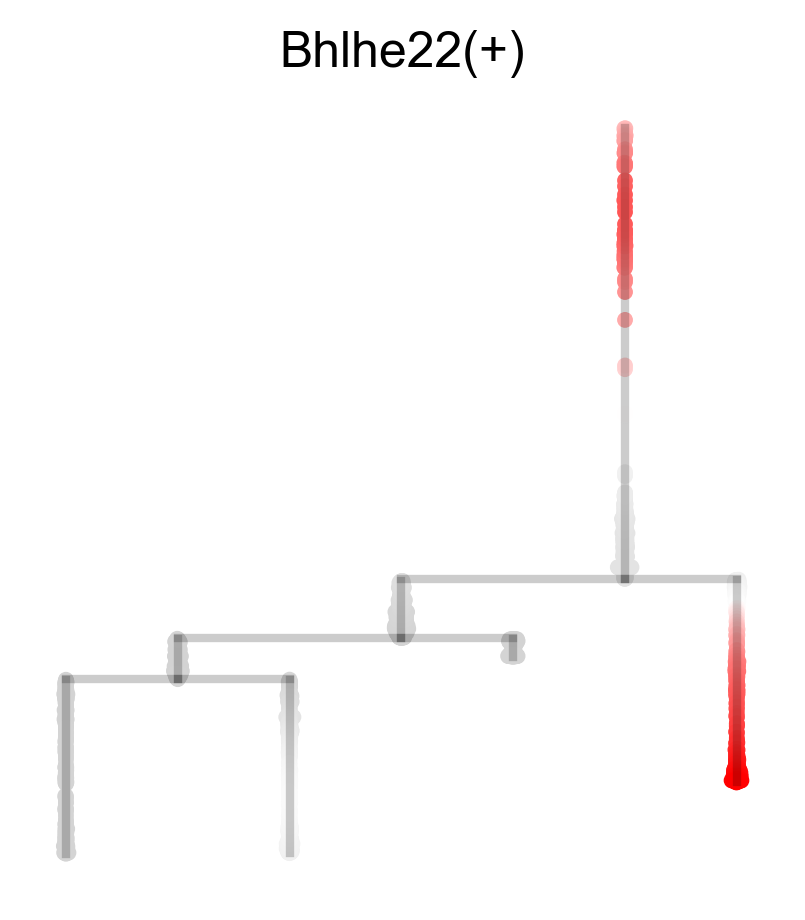

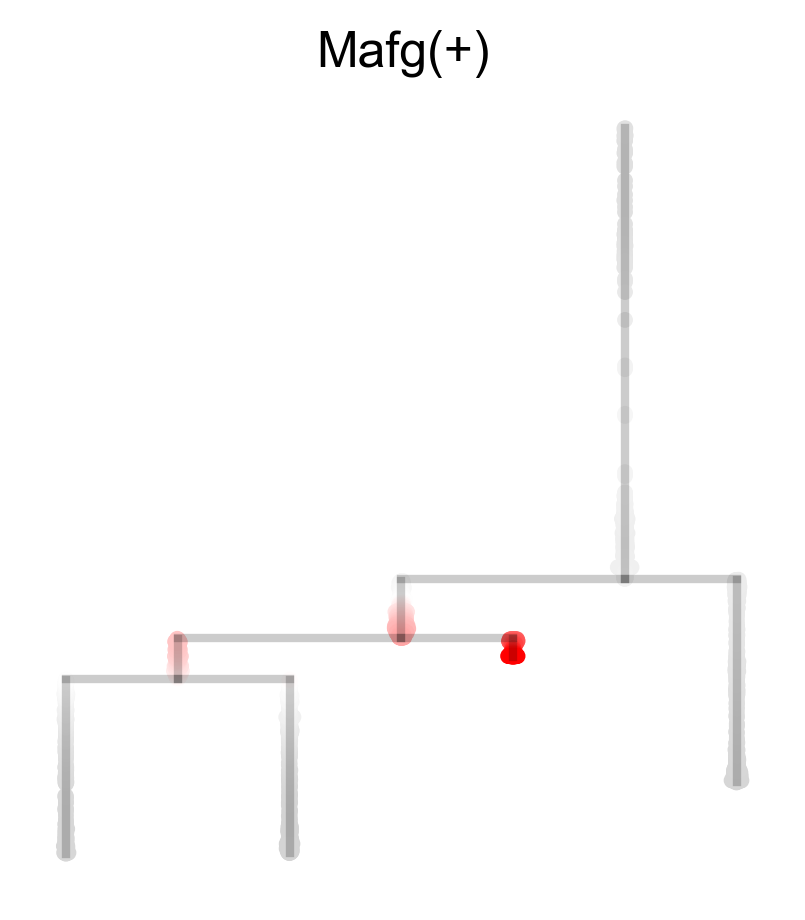

In [51]:
for r in ups.idxmax(axis=1)[ups.sum(axis=1)==1].index:
    scf.pl.dendrogram(adata,color=r,alpha_seg=.2,linewidth_seg=2,
                  show_info=False,cmap=cmap,layer="fitted",save="_{}_regulon.svg".format(r))

In [57]:
alle=np.concatenate([alles.idxmax(axis=1)[alles.sum(axis=1)==1].index,ups.idxmax(axis=1)[ups.sum(axis=1)==1].index])

In [59]:
alle=np.unique(alle)

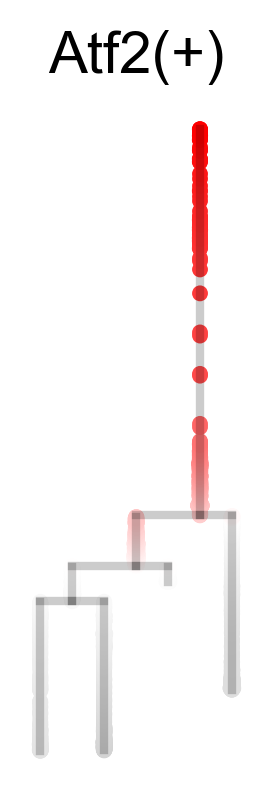

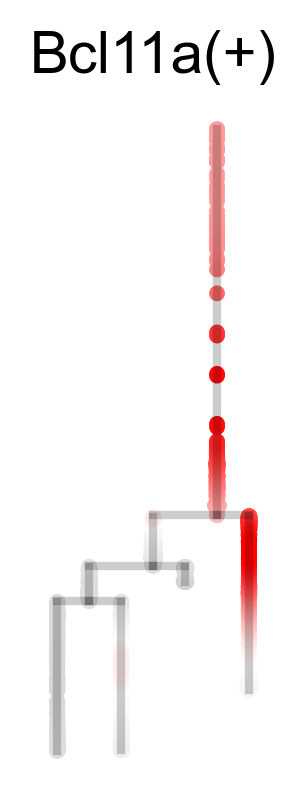

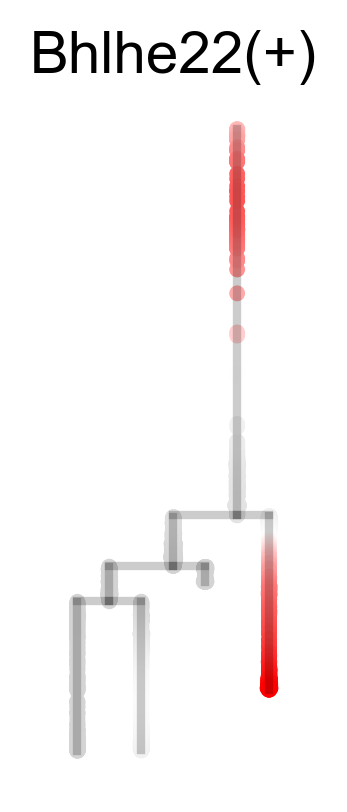

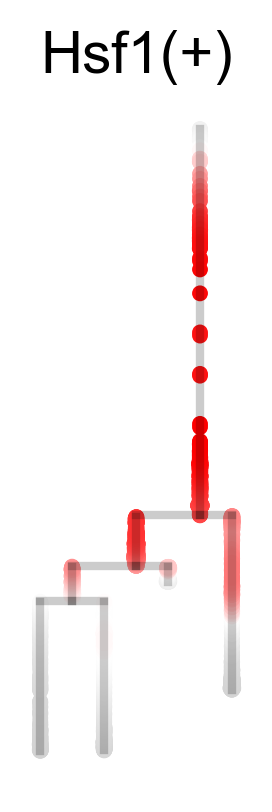

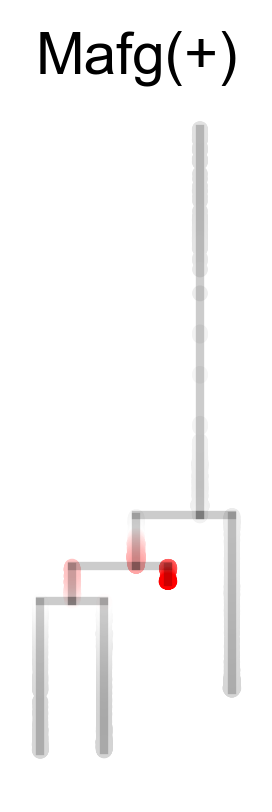

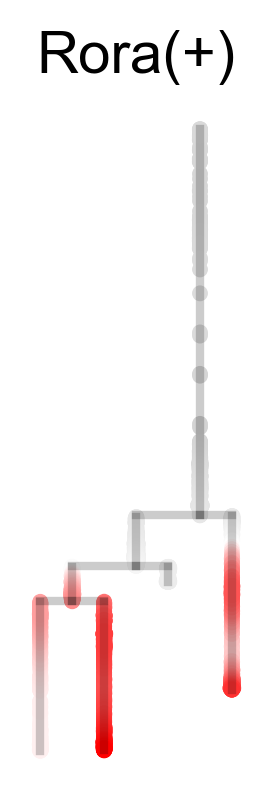

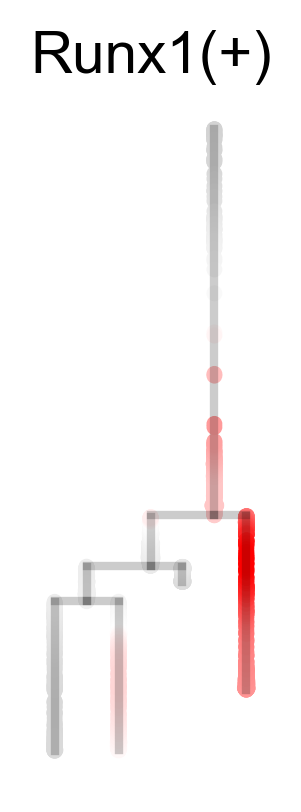

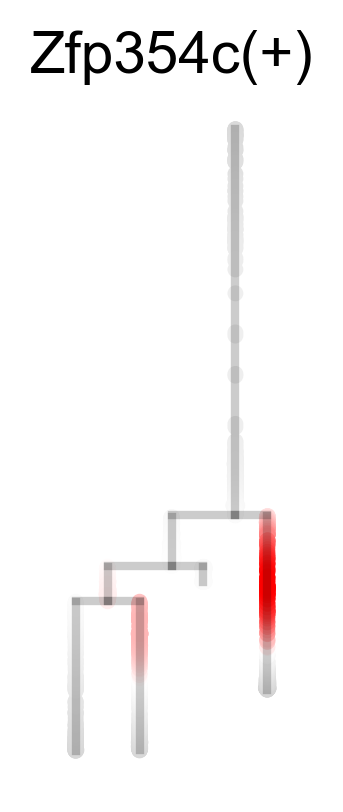

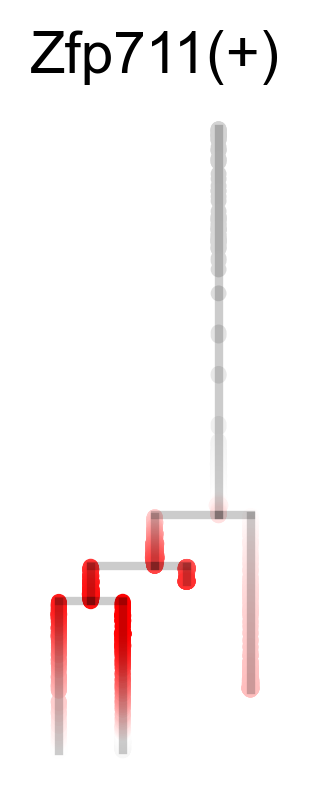

In [63]:
sc.set_figure_params(figsize=(1,3),frameon=False,dpi=150)
for r in alle:
    scf.pl.dendrogram(adata,color=r,alpha_seg=.2,linewidth_seg=2,
                  show_info=False,cmap=cmap,layer="fitted",save="_{}_regulon.svg".format(r))

In [182]:
downs.idxmax(axis=1)[downs.sum(axis=1)==1].index

Index(['Atf2(+)', 'Hsf1(+)', 'Mafb(+)', 'Zfp711(+)', 'Nr1d1(+)', 'Zfp354c(+)'], dtype='object')

In [71]:
sc.set_figure_params(figsize=(1,3),frameon=False,dpi=150,dpi_save=600)
scf.pl.dendrogram(adata,color="Neurod1(+)",alpha_seg=.2,linewidth_seg=2,
                  show_info=False,cmap=cmap,layer="fitted",vmax="p95",save="_Neurod1_regulon.svg")

Bcl11a(+)     Ib
Rora(+)       Ib
Runx1(+)      Ib
Bhlhe22(+)    Ic
Mafg(+)       II
dtype: object

In [72]:
downs.idxmax(axis=1)[downs.sum(axis=1)==1]

Atf2(+)       Ib
Hsf1(+)       Ib
Mafb(+)       Ib
Zfp711(+)     Ib
Nr1d1(+)      Ic
Zfp354c(+)    Ic
dtype: object

In [73]:
alles.idxmax(axis=1)[alles.sum(axis=1)==1]

Atf2(+)       Ib
Hsf1(+)       Ib
Rora(+)       Ib
Zfp711(+)     Ib
Bhlhe22(+)    Ic
Zfp354c(+)    Ic
dtype: object

In [74]:
scf.tl.cluster(adata_Ia,knn=5,metric="correlation")
scf.tl.cluster(adata_Ib,knn=5,metric="correlation")
scf.tl.cluster(adata_Ic,knn=5,metric="correlation")
scf.tl.cluster(adata_II,knn=5,metric="correlation")

    clustering using phenograph
Finding 5 nearest neighbors using correlation metric and 'brute' algorithm
Neighbors computed in 0.006175518035888672 seconds
Jaccard graph constructed in 0.0033597946166992188 seconds
Wrote graph to binary file in 0.0021572113037109375 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.719018
Louvain completed 21 runs in 1.152003526687622 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 4.159487247467041 seconds
    finished (0:04:21) --> added
    .var['fit_clusters'], cluster assignments for features.
    clustering using phenograph
Finding 5 nearest neighbors using correlation metric and 'brute' algorithm
Neighbors computed in 0.006043195724487305 seconds
Jaccard graph constructed in 0.006512880325317383 seconds
Wrote graph to binary file in 0.001592397689819336 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.650185
Louvain completed 21 runs i

In [75]:
adata_Ia.var.fit_clusters.unique()

array([-1,  0])

In [76]:
adata_Ib.var.fit_clusters.unique()

array([ 0, -1])

In [77]:
adata_Ic.var.fit_clusters.unique()

array([-1,  0])

In [78]:
adata_II.var.fit_clusters.unique()

array([-1])

In [49]:
scf.tl.test_association(adata,n_jobs=20,A_cut=0.01)

test features for association with the trajectory
    single mapping :   0%|          | 0/427 [00:00<?, ?it/s]

/home/lfaure/miniconda3/envs/bio-gpu-18/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    single mapping : 100%|██████████| 427/427 [00:16<00:00, 25.64it/s]
    found 140 significant features (0:00:16) --> added
    .var['p_val'] values from statistical test.
    .var['fdr'] corrected values from multiple testing.
    .var['st'] proportion of mapping in which feature is significant.
    .var['A'] amplitue of change of tested feature.
    .var['signi'] feature is significantly changing along pseudotime.
    .uns['stat_assoc_list'] list of fitted features on the graph for all mappings.


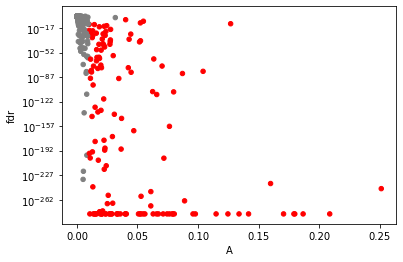

In [50]:
scf.pl.test_association(adata)

In [51]:
scf.tl.fit(adata,n_jobs=20)

fit features associated with the trajectory
    single mapping :   0%|          | 0/140 [00:00<?, ?it/s]

/home/lfaure/miniconda3/envs/bio-gpu-18/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


    single mapping : 100%|██████████| 140/140 [00:03<00:00, 38.48it/s]
    finished (adata subsetted to keep only fitted features!) (0:00:03) --> added
    .layers['fitted'], fitted features on the trajectory for all mappings.
    .raw, unfiltered data.


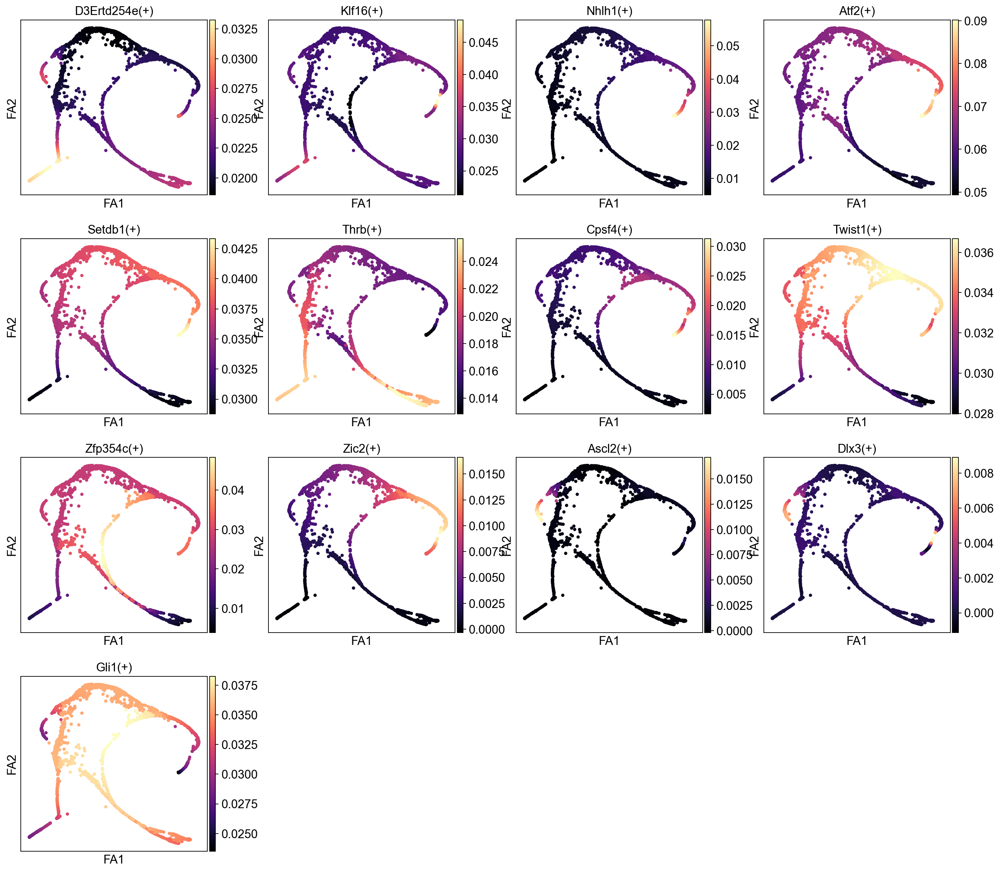

In [66]:
sc.set_figure_params()
sc.pl.draw_graph(adata,color=alles.idxmax(axis=1)[alles.sum(axis=1)==1].index,layer="fitted",cmap="magma")

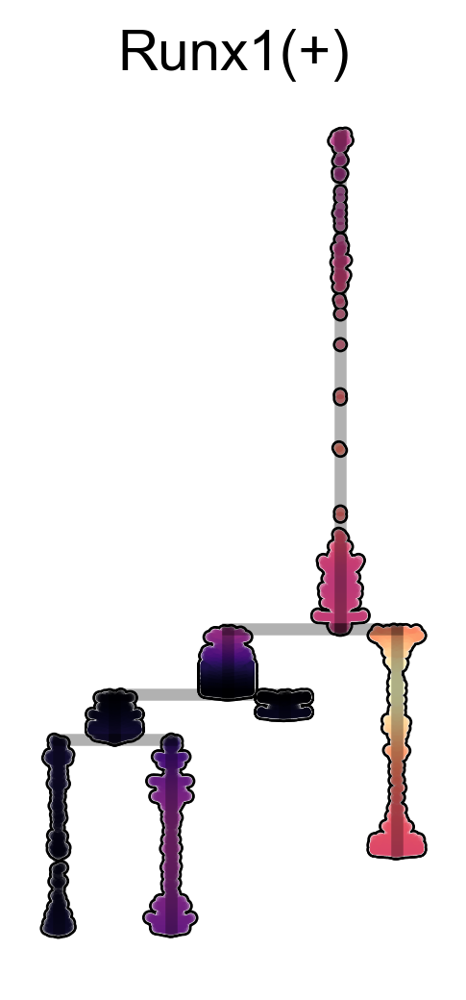

In [86]:
sc.set_figure_params(figsize=(2,4),frameon=False,dpi=150)
scf.pl.dendrogram(adata,color="Runx1(+)",layer="fitted",s=20,cmap="magma",add_outline=True,show_info=False)

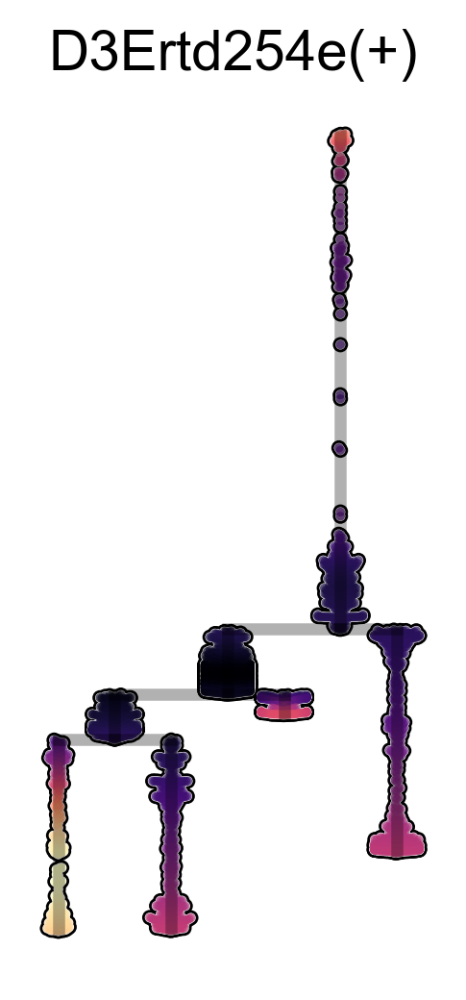

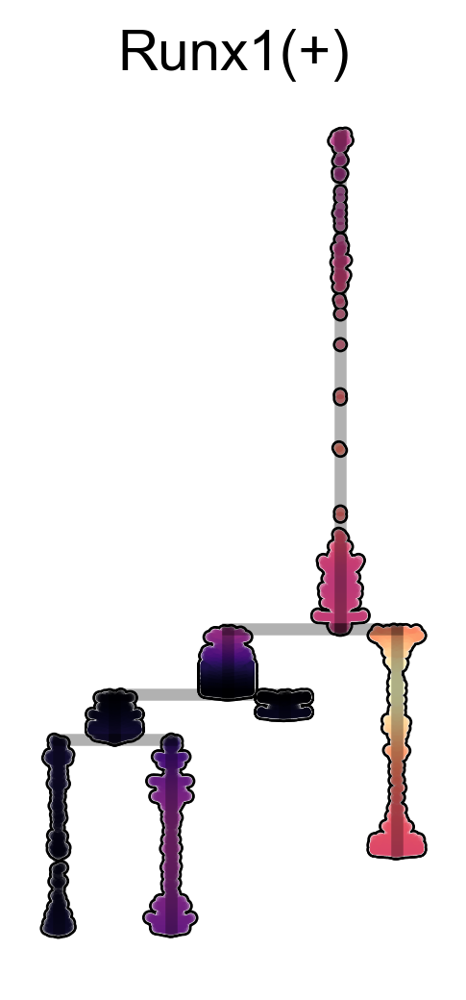

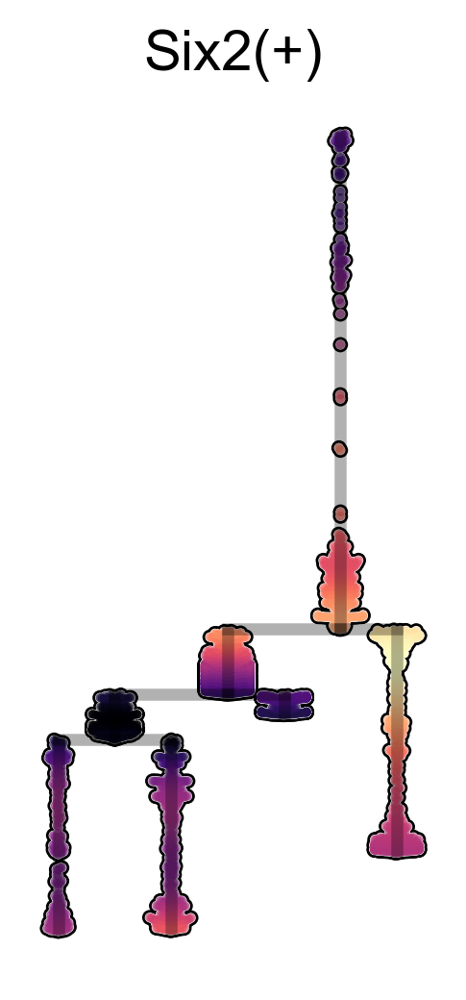

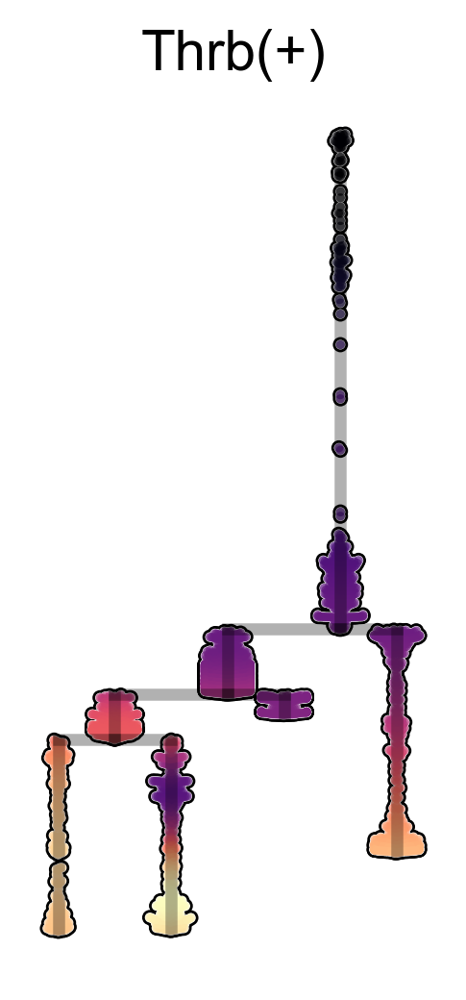

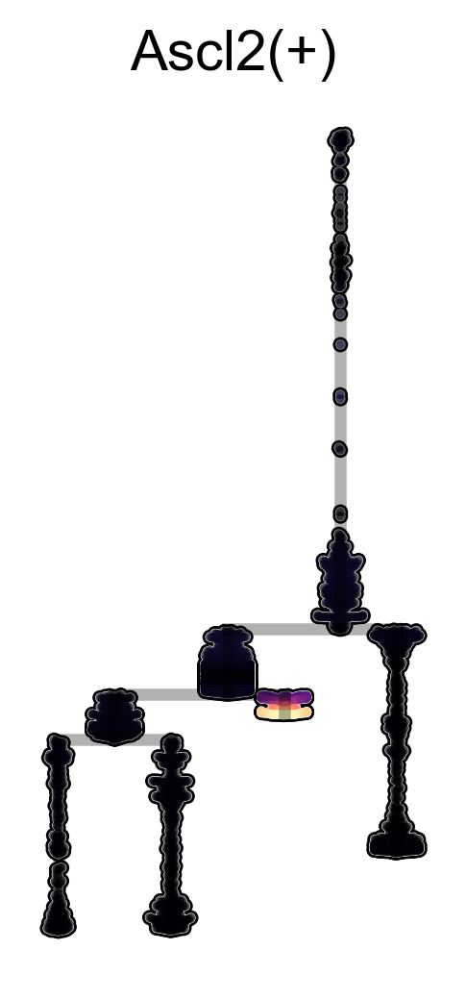

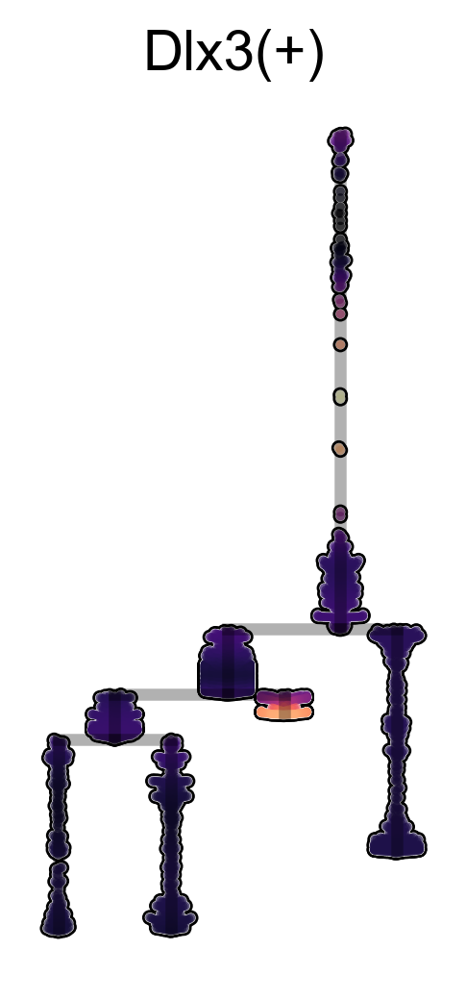

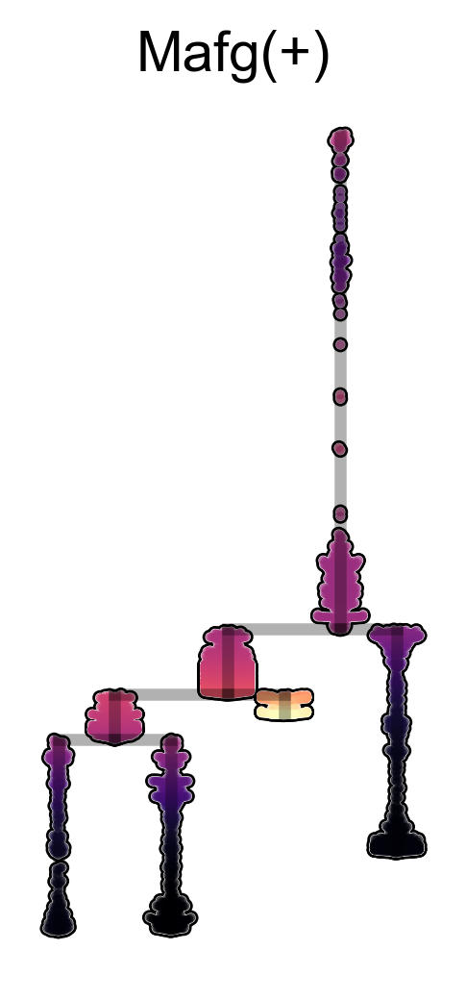

In [89]:
for g in ["D3Ertd254e(+)","Runx1(+)","Six2(+)","Thrb(+)","Ascl2(+)","Dlx3(+)","Mafg(+)"]:
    scf.pl.dendrogram(adata,color=g,layer="fitted",s=20,cmap="magma",add_outline=True,show_info=False,save=g+".svg")

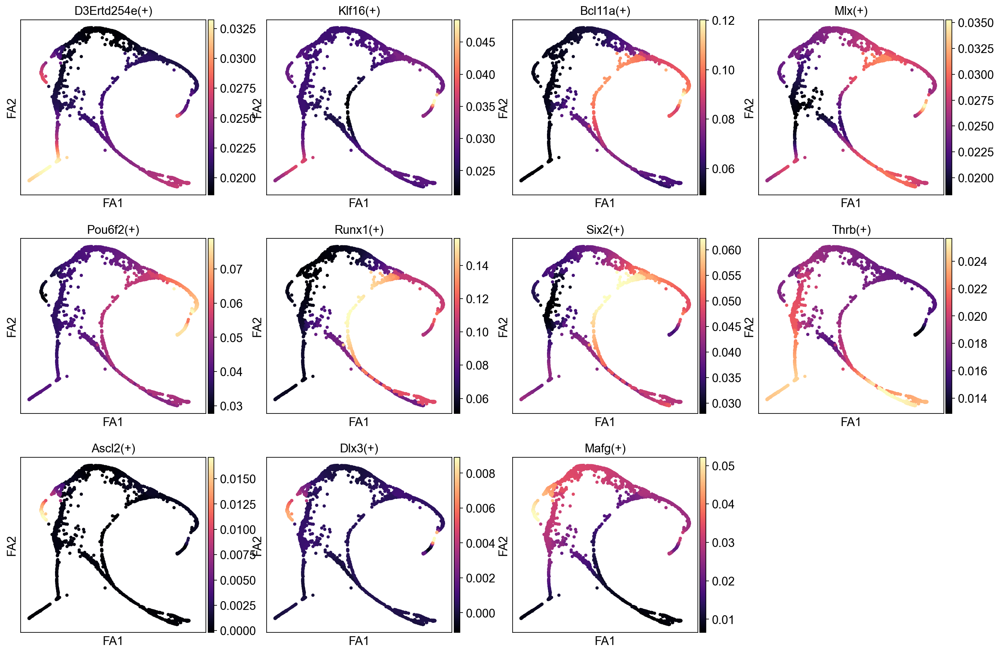

In [65]:
sc.set_figure_params()
sc.pl.draw_graph(adata,color=ups.idxmax(axis=1)[ups.sum(axis=1)==1].index,layer="fitted",cmap="magma")

In [53]:
adata[:,alles.idxmax(axis=1)[alles.sum(axis=1)==1].index]

/home/lfaure/miniconda3/envs/bio-gpu-18/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


View of AnnData object with n_obs × n_vars = 2072 × 13
    obs: 'batch', 'plate', 'devtime', 'n_genes_by_counts', 'total_counts', 'total_counts_ERCC', 'pct_counts_ERCC', 'doublet_score', 'leiden', 'leiden_diagnostic', 't', 'seg', 'edge', 'milestones', 'devtime_float'
    var: 'p_val', 'A', 'fdr', 'st', 'signi'
    uns: 'dendro_segments', 'devtime_colors', 'draw_graph', 'graph', 'leiden', 'leiden_colors', 'leiden_diagnostic_colors', 'log1p', 'milestones_colors', 'neighbors', 'ppt', 'pseudotime_list', 'scrublet', 'seg_colors', 'tsne', 'umap', 'stat_assoc_list'
    obsm: 'X_dendro', 'X_draw_graph_fa', 'X_msdiff', 'X_pca', 'X_tsne', 'X_umap'
    layers: 'fitted'

In [79]:
scf.tl.cluster(adata,knn=5,metric="correlation")

    clustering using phenograph
Finding 5 nearest neighbors using correlation metric and 'brute' algorithm
Neighbors computed in 0.024182558059692383 seconds
Jaccard graph constructed in 0.008118629455566406 seconds
Wrote graph to binary file in 0.005199432373046875 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.797239
Louvain completed 21 runs in 1.1520869731903076 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 4.264965057373047 seconds
    finished (0:34:21) --> added
    .var['fit_clusters'], cluster assignments for features.


In [80]:
adata.var.fit_clusters.unique()

array([ 5,  1,  3, -1,  0,  4,  2,  6])

/home/lfaure/miniconda3/envs/bio-gpu-18/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


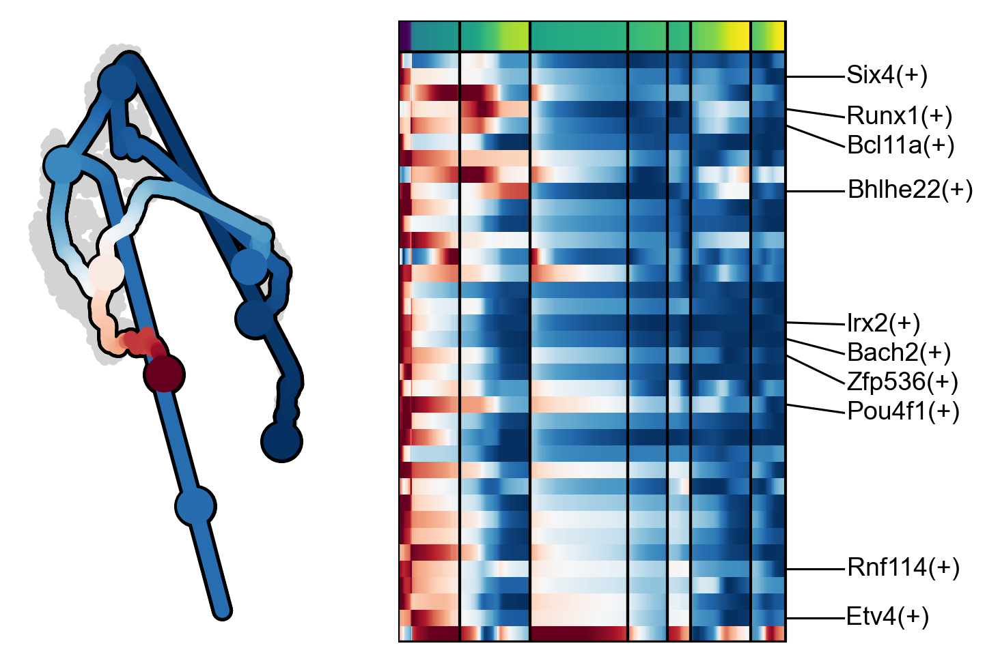

/home/lfaure/miniconda3/envs/bio-gpu-18/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


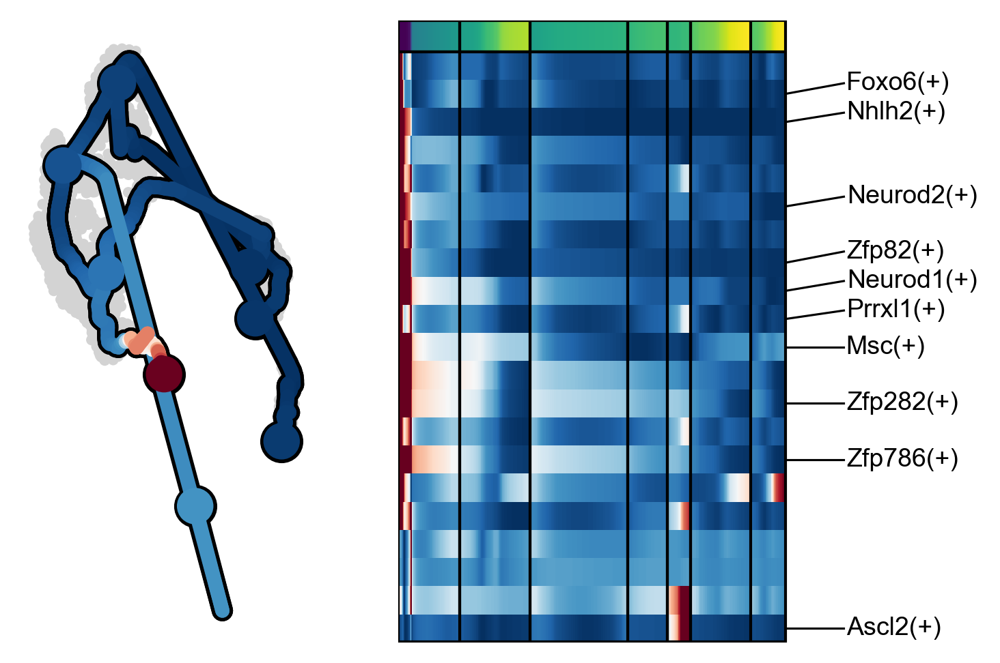

/home/lfaure/miniconda3/envs/bio-gpu-18/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


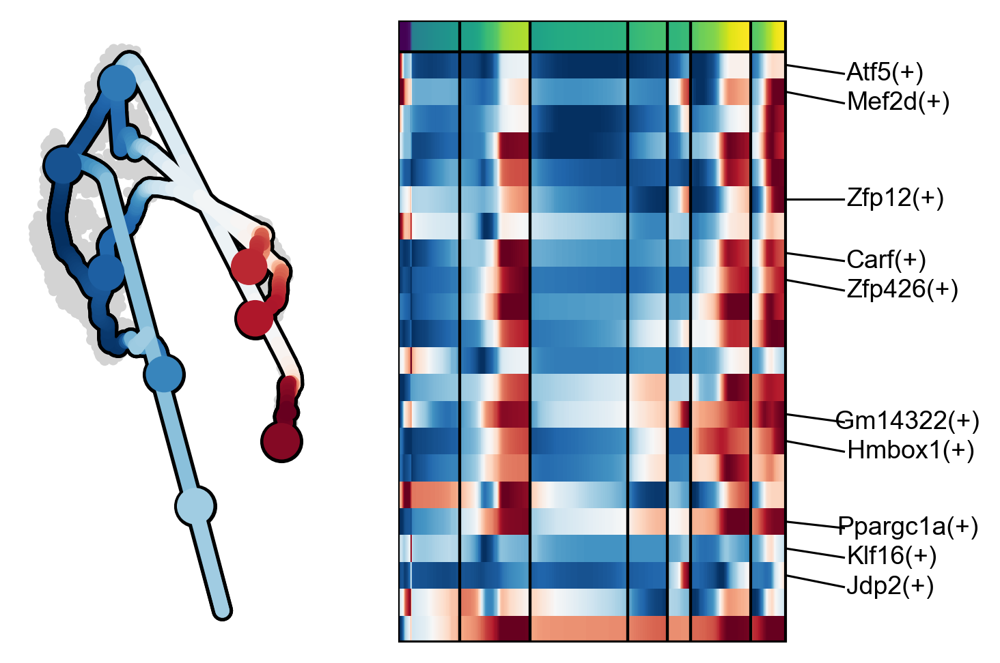

/home/lfaure/miniconda3/envs/bio-gpu-18/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


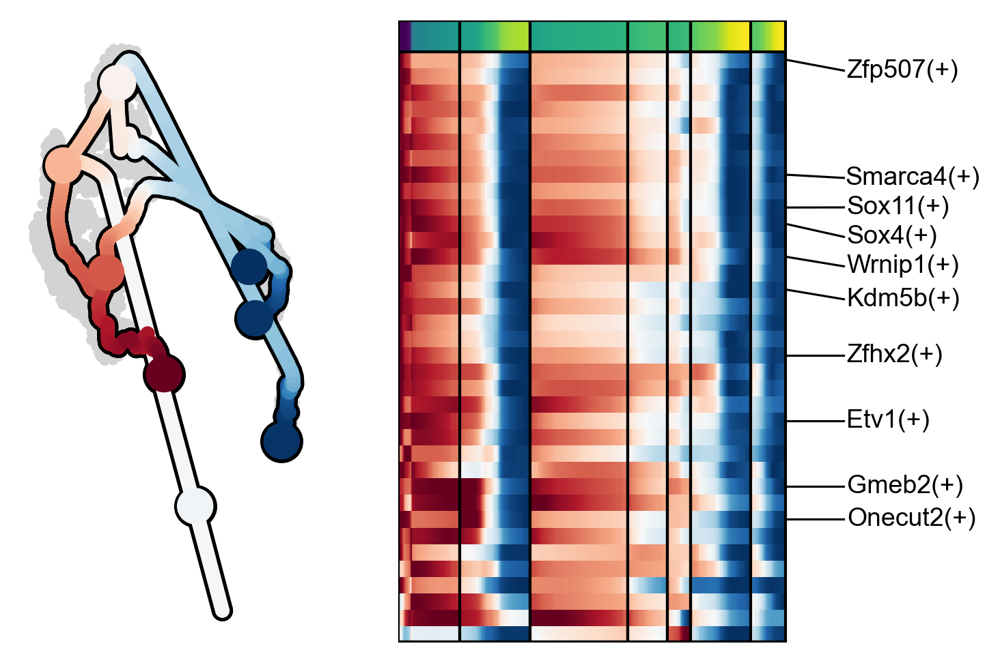

/home/lfaure/miniconda3/envs/bio-gpu-18/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


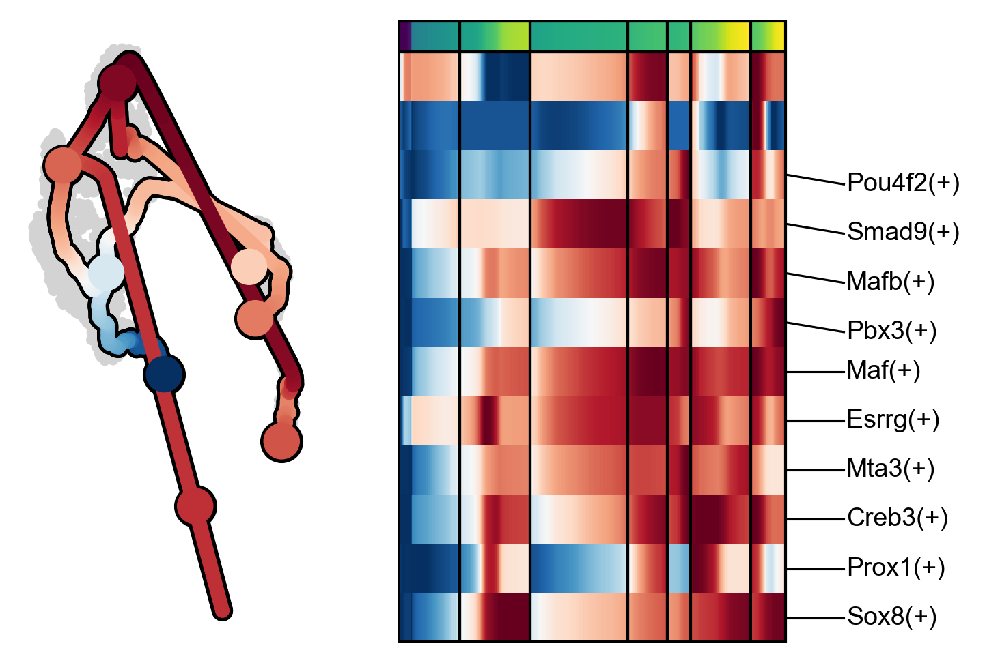

/home/lfaure/miniconda3/envs/bio-gpu-18/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


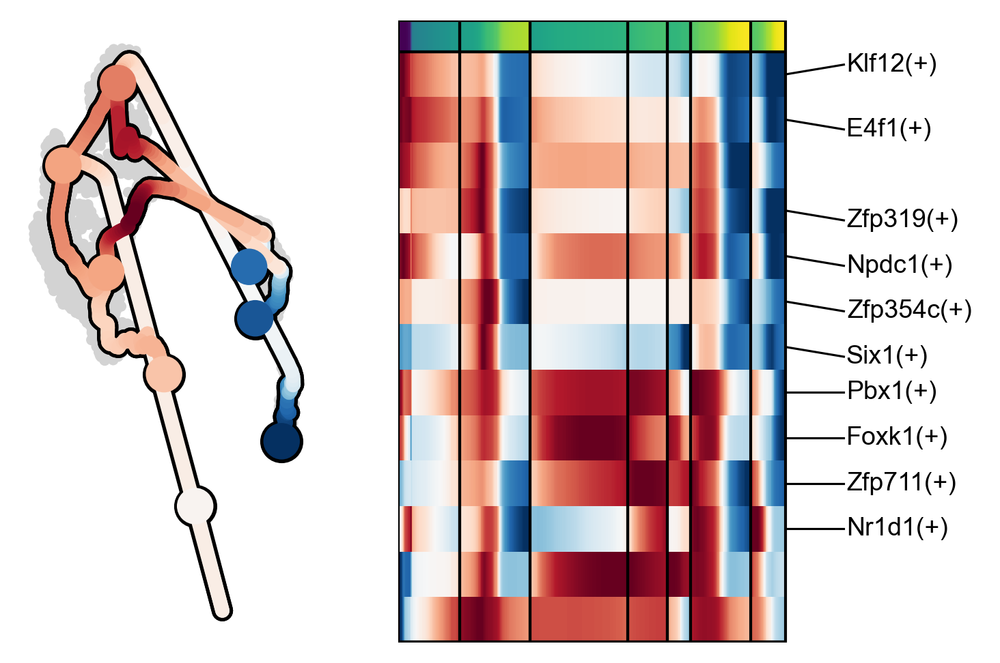

In [290]:
from scipy import stats
from scipy.optimize import minimize_scalar
from sklearn import mixture
seed=0

def get_contours(c,offset=.1):
    scf.pl.trends(adata,features=adata.var_names[adata.var.fit_clusters==c],output_mean=True,show=False)
    data=adata.obs.mean_trajectory
    gmm2 = mixture.GaussianMixture(n_components=2, covariance_type='full', random_state=seed).fit(
                data.values.reshape(-1, 1)
            )
    thre=minimize_scalar(fun=stats.gaussian_kde(data), bounds=sorted(gmm2.means_), method='bounded').x[0]
    thre=thre+offset
    #thre=data.mean() + 2.0 * data.std()
    adata.obs["sel"+str(c)]=(adata.obs.mean_trajectory>thre).astype(str)

    
for c in adata.var.fit_clusters.unique():
    get_contours(c)


In [ ]:
adata.obs

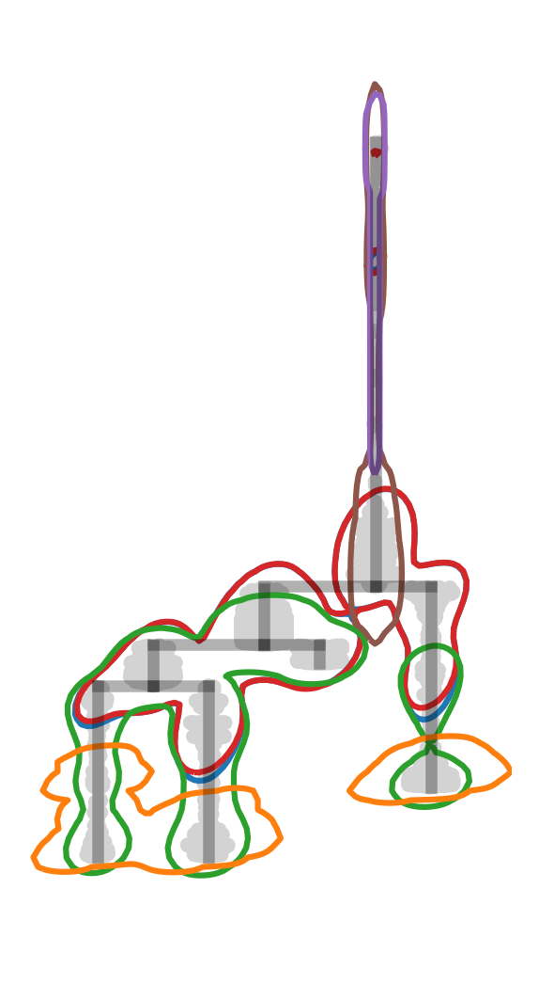

In [292]:
import numpy as np

fig ,ax =plt.subplots(figsize=(2.2,4.4),dpi=150)
scf.pl.dendrogram(adata,show=False,ax=ax,frameon=False)
bins = 100   
xmin, xmax = ax.get_xlim()
ymin, ymax = ax.get_ylim()
ax.set_xlim([xmin-(xmax-xmin)*.1,xmax+(xmax-xmin)*.1])
ax.set_ylim([ymin-(ymax-ymin)*.1,ymax+(ymax-ymin)*.1])

xmin, xmax = ax.get_xlim()
ymin, ymax = ax.get_ylim()

# prepare grid for density map
xedges = np.linspace(xmin, xmax, bins)
yedges = np.linspace(ymin, ymax, bins)
xx, yy = np.meshgrid(xedges, yedges)
gridpoints = np.array([xx.ravel(), yy.ravel()])

def get_densities(c):
    x=adata.obsm["X_dendro"][adata.obs["sel"+str(c)]=="True",0]
    y=adata.obsm["X_dendro"][adata.obs["sel"+str(c)]=="True",1]

    xy = np.vstack((x, y))
    dens = stats.gaussian_kde(xy,bw_method=.2)
    z = dens(xy)

    # mask points above density threshold
    threshold = 0.01
    x = np.ma.masked_where(z > threshold, x)
    y = np.ma.masked_where(z > threshold, y)

    zz = np.reshape(dens(gridpoints), xx.shape)

    return zz,sum(z > threshold)

res=dict(zip(adata.var.fit_clusters.unique(),[get_densities(c) for c in adata.var.fit_clusters.unique()]))
sizes=pd.Series([res[c][1] for c in adata.var.fit_clusters.unique()],index=adata.var.fit_clusters.unique())
cols=["tab:blue","tab:red","tab:green","tab:orange","tab:brown","tab:purple"]
for i,c in enumerate(sizes.sort_values(ascending=False).index):
    #cs = ax.contourf(xx, yy, res[c][0], levels=[threshold,threshold+1], colors=cols[i],zorder=-10+1)
    cs = ax.contour(xx, yy, res[c][0], levels=[threshold], colors=cols[i])

In [294]:
sizes.sort_values(ascending=False).index

Int64Index([4, 1, 5, 2, 0, 3], dtype='int64')

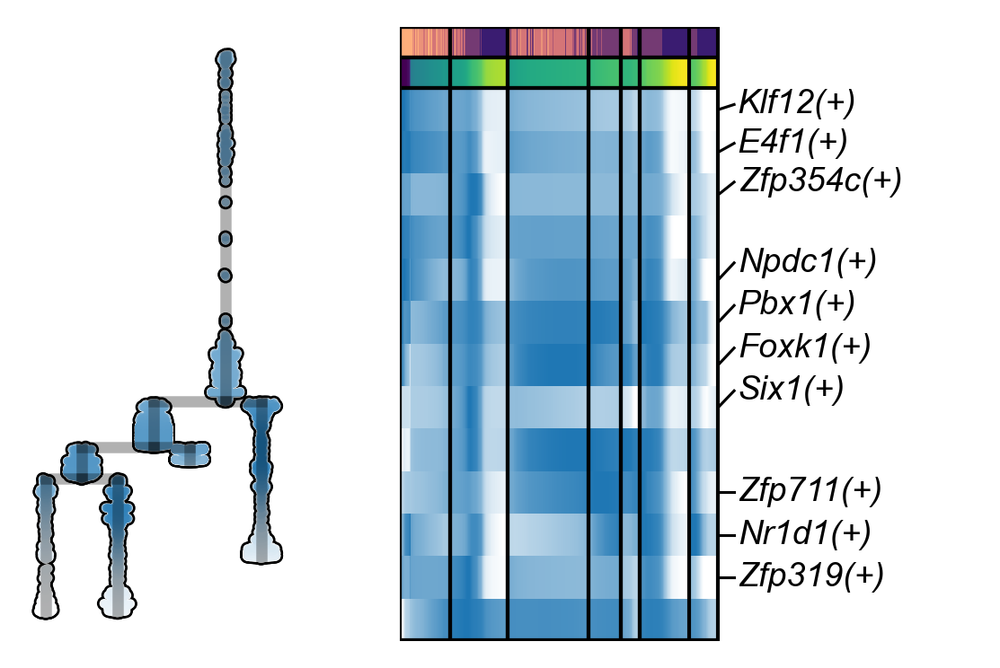

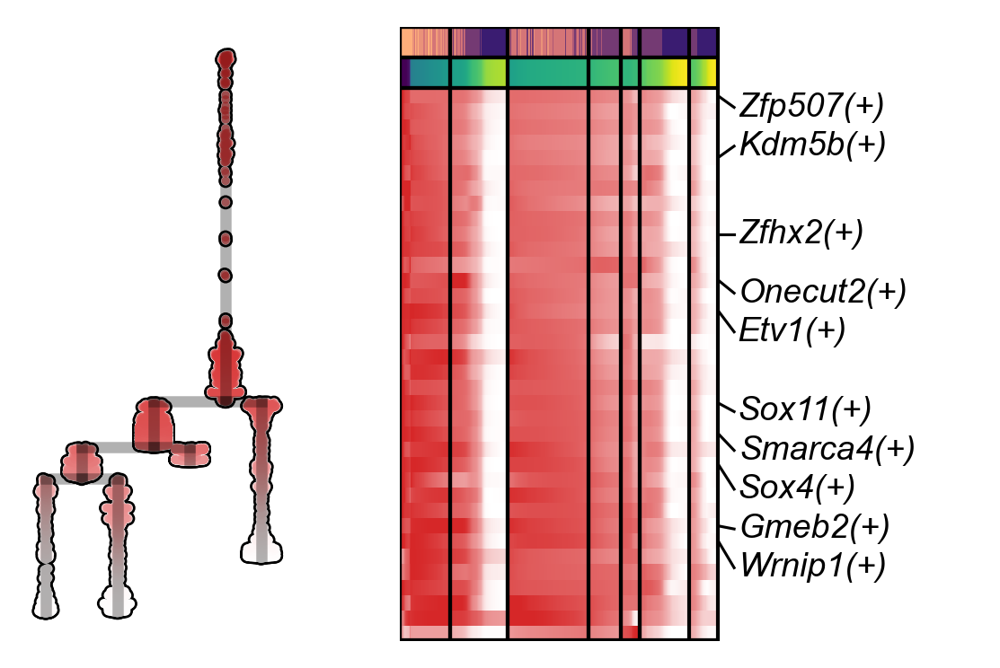

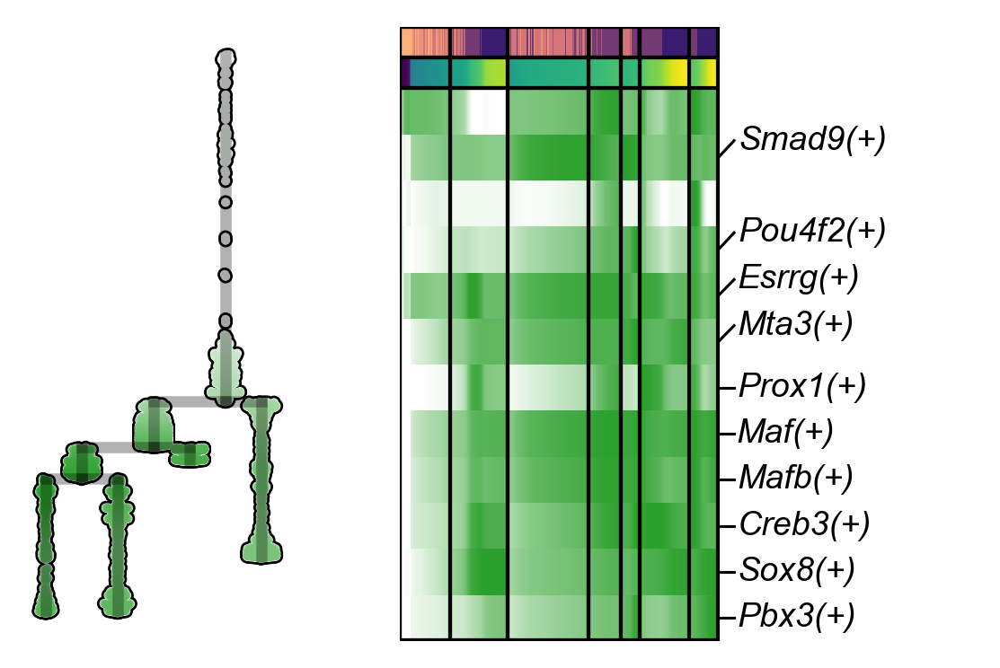

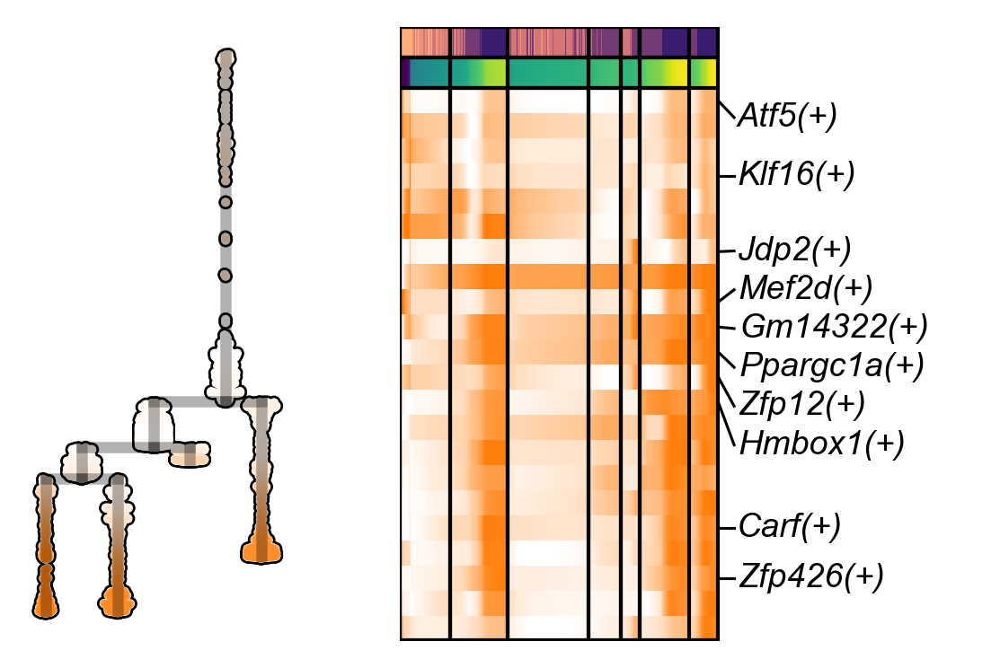

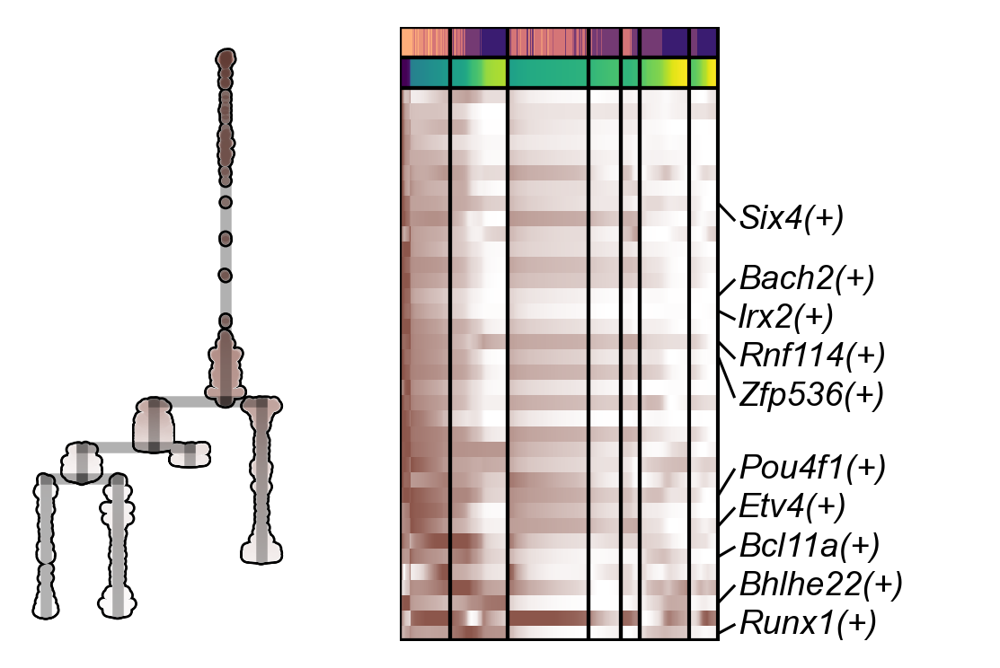

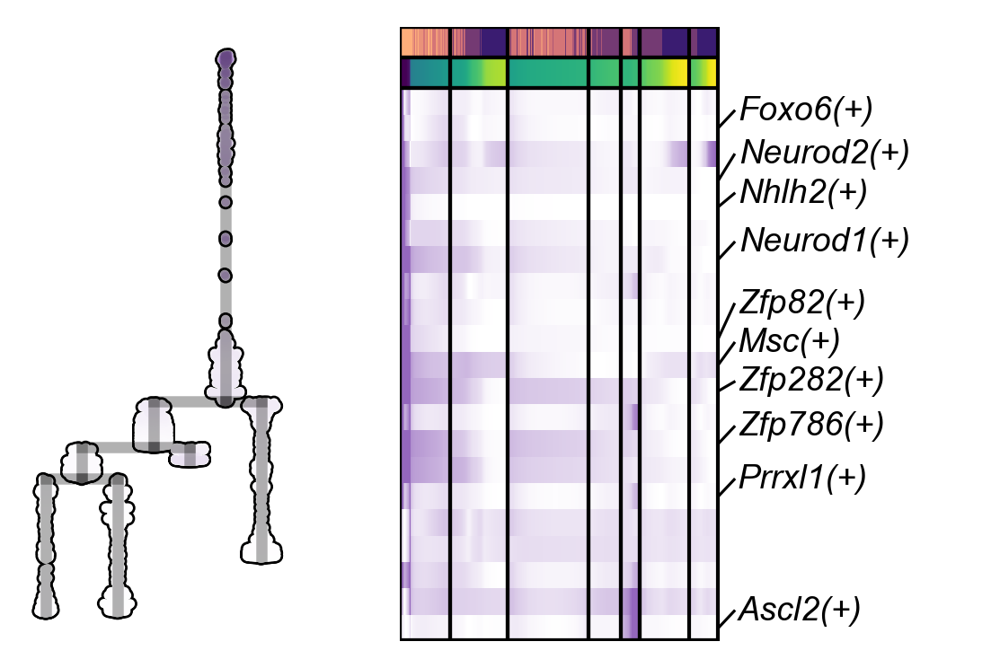

In [293]:
from matplotlib.colors import LinearSegmentedColormap
sc.set_figure_params(figsize=(2,4),dpi_save=600,frameon=False,dpi=150)
for i,c in enumerate(sizes.sort_values(ascending=False).index):
    scf.pl.trends(adata,features=adata.var_names[adata.var.fit_clusters==c],
                  style="italic",annot="devtime",
                  feature_cmap=LinearSegmentedColormap.from_list(name="tab",colors=["white",cols[i]]),
                  add_outline=True,s=20,fig_heigth=3,heatmap_space=.2,offset_names=.05,
                  basis="dendro",ordering="max",pseudo_cmap="viridis")